<b><font size="6">Machine Learning Project Group 7</font></b><br><br>

Anna Kwiatkowska, Stefano Sperti

In [1]:
#import libraries
import pandas as pd
import numpy as np
import os 
import csv 
from urllib import request 
from pathlib import Path 

from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder


import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.feature_selection import f_classif #computes the F-values for the dataset
from sklearn.feature_selection import SelectKBest #Chooses the k with the highest values
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
#setting seaborn visual style in plt
sns.set()

from collections import Counter #need it because we will make the counter

#sk-learn scaling algorithm
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import f_classif #computes the F-values for the dataset
from sklearn.feature_selection import SelectKBest #Chooses the k with the highest values

from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score

#Linear Regression

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, r2_score

#logisti regression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

#decision and regression tree
import os
import warnings
import time
warnings.filterwarnings('ignore')

from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error

from sklearn import tree
from sklearn.tree import export_graphviz

from sklearn.tree import DecisionTreeRegressor

#GridSearch
from sklearn.model_selection import GridSearchCV

#NN
from sklearn.linear_model import Perceptron
from sklearn.neural_network import MLPRegressor


<a class="anchor" id="">

# 1. Import data (Data Integration)

</a>


<img src="image/step1.png" style="height:60px">

In [2]:
df = pd.read_csv('train.csv')
print(df)

data_raw = df.copy()

       InstanceID  Season  Year      Month  HourofDay  Holiday  DayofWeek  \
0           78224  Spring   4.0        May        8.0      0.0  Wednesday   
1           53017  Spring   3.0      April        3.0      0.0   Saturday   
2           88477    Fall   3.0    October       17.0      0.0    Tuesday   
3           21418  Summer   3.0  September       13.0      0.0   Thursday   
4           24928  Summer   4.0       June        9.0      0.0    Tuesday   
...           ...     ...   ...        ...        ...      ...        ...   
13950       59922    Fall   3.0   November       11.0      0.0   Thursday   
13951       55203    Fall   4.0    October        0.0      0.0   Thursday   
13952       29860  Winter   4.0    January       19.0      0.0   Saturday   
13953       12382  Summer   3.0  September        4.0      0.0     Sunday   
13954       77932  Winter   4.0   February        6.0      0.0     Sunday   

       WorkingDay WeatherForecast  Temperature  FeltTemperature  Humidity  

In [3]:
test = pd.read_csv('test.csv')
print(test)

test_raw = test.copy()

      InstanceID  Season  Year     Month  HourofDay  Holiday DayofWeek  \
0          72270  Spring   4.0      June        3.0      0.0    Sunday   
1          79321    Fall   3.0  November        0.0      0.0    Sunday   
2          66738  Winter   3.0     March        0.0      0.0    Monday   
3          42387  Spring   3.0      June        4.0      0.0  Saturday   
4          86803  Spring   3.0      June        5.0      0.0   Tuesday   
...          ...     ...   ...       ...        ...      ...       ...   
4688       33525  Spring   3.0       May       15.0      0.0   Tuesday   
4689       80263  Summer   4.0    August        6.0      0.0  Saturday   
4690       91916    Fall   4.0  November        6.0      0.0    Sunday   
4691       47074  Summer   3.0    August       13.0      0.0    Friday   
4692       64513    Fall   3.0   October        3.0      0.0  Thursday   

      WorkingDay WeatherForecast  Temperature  FeltTemperature  Humidity  \
0            0.0           Clear   

<a class="anchor" id="">

# 2. Explore data (Data access, exploration and understanding)

</a>

<img src="image/step2.png" style="height:60px">

In [4]:
data_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13955 entries, 0 to 13954
Data columns (total 18 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   InstanceID                          13955 non-null  int64  
 1   Season                              13870 non-null  object 
 2   Year                                13888 non-null  float64
 3   Month                               13886 non-null  object 
 4   HourofDay                           13883 non-null  float64
 5   Holiday                             13870 non-null  float64
 6   DayofWeek                           13887 non-null  object 
 7   WorkingDay                          13886 non-null  float64
 8   WeatherForecast                     13890 non-null  object 
 9   Temperature                         13894 non-null  float64
 10  FeltTemperature                     13892 non-null  float64
 11  Humidity                            13898

In [5]:
data_raw.describe()

,InstanceID,Year,HourofDay,Holiday,WorkingDay,Temperature,FeltTemperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,City_Detroit,WeekofYear,RidesBooked
count,13955.000000,13888.000000,13883.000000,13870.000000,13886.000000,13894.000000,13892.000000,13898.000000,13876.000000,13887.000000,13882.000000,13876.0,13888.000000,13955.000000
mean,55010.909137,3.503528,11.541742,0.029200,0.682558,13.075341,16.189178,0.626759,0.189967,15.637287,19.845969,1.0,26.659778,569.746972
std,26206.253028,0.500006,6.889074,0.168372,0.465498,7.722183,5.849787,0.192956,0.122566,8.757647,8.700009,0.0,15.017542,546.770205
min,10004.000000,3.000000,0.000000,0.000000,0.000000,-6.001000,0.000000,0.000000,0.000000,1.000000,5.001000,1.0,1.000000,3.000000
25%,32428.500000,3.000000,6.000000,0.000000,0.000000,6.783000,11.332200,0.470000,0.104500,8.000000,12.358250,1.0,14.000000,123.000000
50%,55083.000000,4.000000,12.000000,0.000000,1.000000,13.175000,16.483200,0.630000,0.194000,16.000000,19.711000,1.0,27.000000,429.000000
75%,77657.500000,4.000000,17.000000,0.000000,1.000000,19.567000,21.120800,0.780000,0.253700,23.000000,27.296500,1.0,40.000000,843.000000
max,99978.000000,4.000000,23.000000,1.000000,1.000000,33.150000,32.453000,1.000000,0.850700,31.000000,35.000000,1.0,52.000000,2931.000000


In [6]:
#list with the names of the numerical features and a second list of categorical features
numerical_features = ['Year','HourofDay','Holiday','WorkingDay','Temperature','FeltTemperature','Humidity',
                      'WindSpeed','DayofMonth','AverageRideDurationPreviousDay_Min','City_Detroit','WeekofYear','RidesBooked']

categorical_features = ['Season','Month','DayofWeek','WeatherForecast']

not_feature = 'InstanceID'

In [7]:
data_raw.describe(include = 'all').T
#there are no unique values
#city detroit is always = 1

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
InstanceID,13955.0,NaN,NaN,NaN,55010.909137,26206.253028,10004.0,32428.5,55083.0,77657.5,99978.0
Season,13870,4,Summer,3604,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Year,13888.0,NaN,NaN,NaN,3.503528,0.500006,3.0,3.0,4.0,4.0,4.0
Month,13886,12,December,1209,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HourofDay,13883.0,NaN,NaN,NaN,11.541742,6.889074,0.0,6.0,12.0,17.0,23.0
Holiday,13870.0,NaN,NaN,NaN,0.0292,0.168372,0.0,0.0,0.0,0.0,1.0
DayofWeek,13887,7,Sunday,2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WorkingDay,13886.0,NaN,NaN,NaN,0.682558,0.465498,0.0,0.0,1.0,1.0,1.0
WeatherForecast,13890,4,Clear,9079,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Temperature,13894.0,NaN,NaN,NaN,13.075341,7.722183,-6.001,6.783,13.175,19.567,33.15


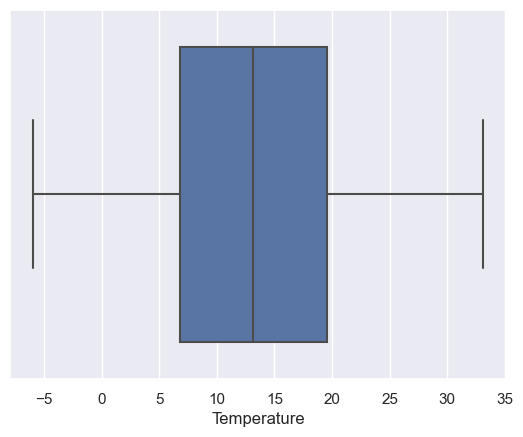

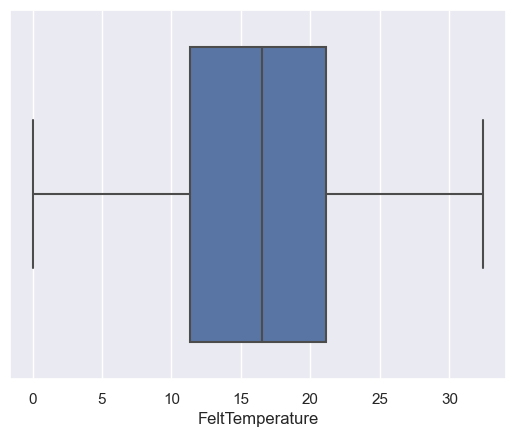

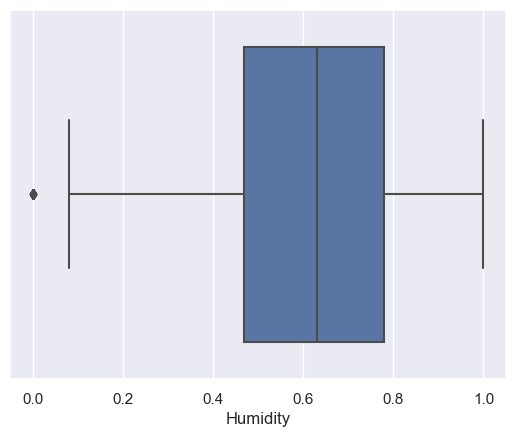

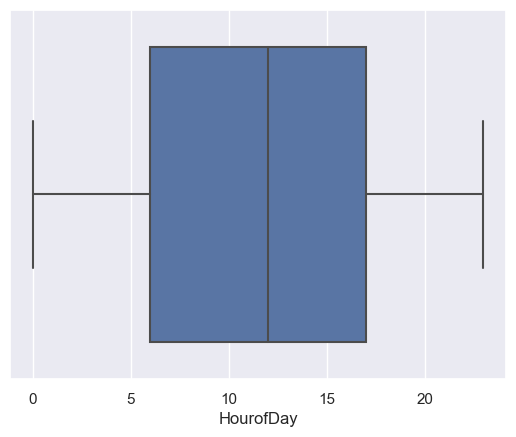

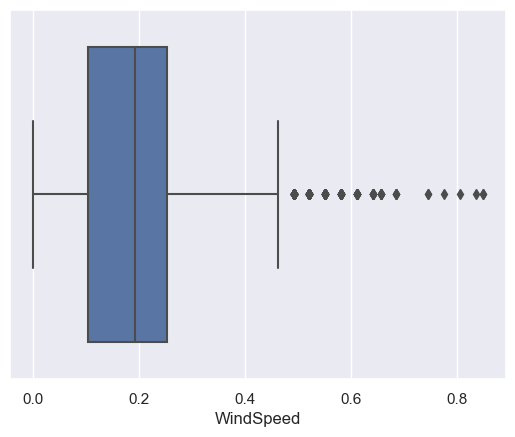

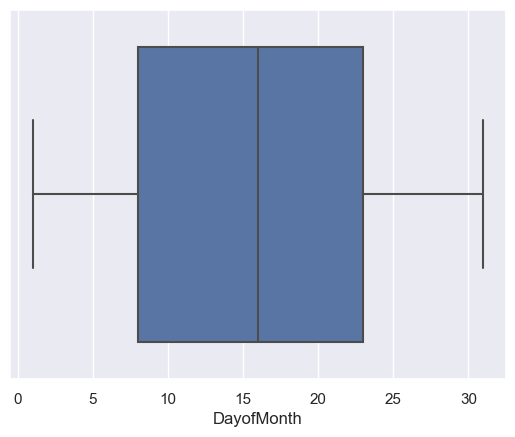

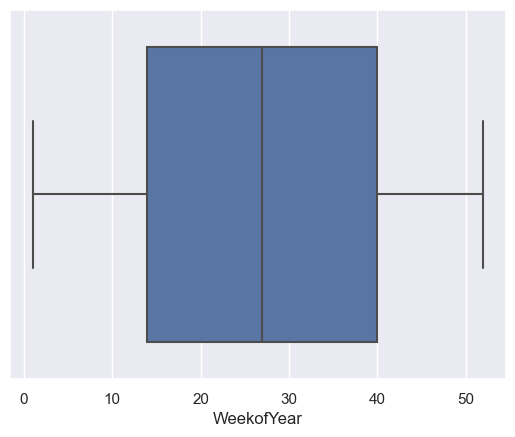

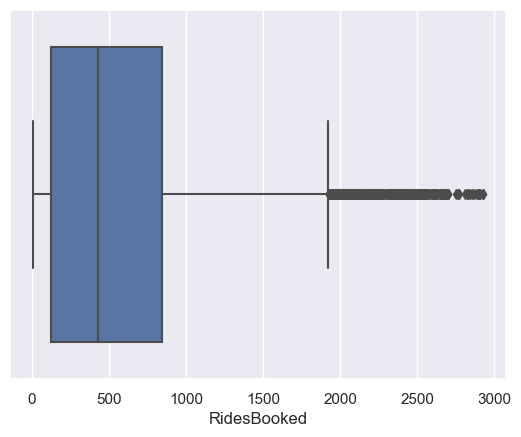

In [8]:
sns.boxplot(data = data_raw, x= 'Temperature')
plt.show()




sns.boxplot(data = data_raw, x= 'FeltTemperature')
plt.show()



sns.boxplot(data = data_raw, x= 'Humidity')
plt.show()



sns.boxplot(data = data_raw, x= 'HourofDay')
plt.show()


sns.boxplot(data = data_raw, x= 'WindSpeed')
plt.show()



sns.boxplot(data = data_raw, x= 'DayofMonth')
plt.show()


sns.boxplot(data = data_raw, x= 'WeekofYear')
plt.show()

sns.boxplot(data = data_raw, x= 'RidesBooked')
plt.show()




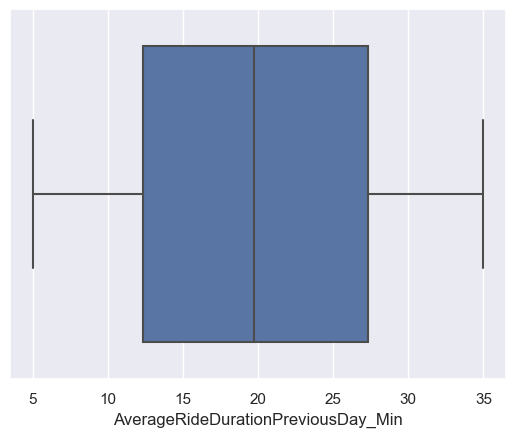

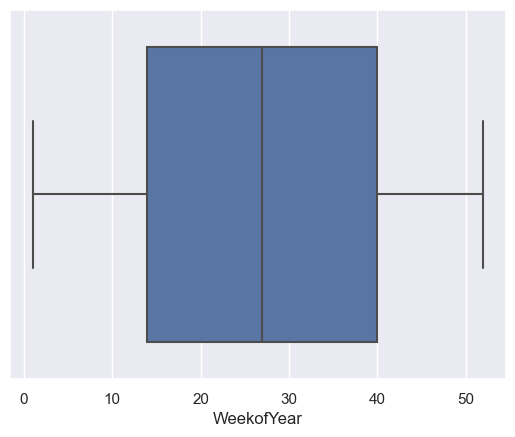

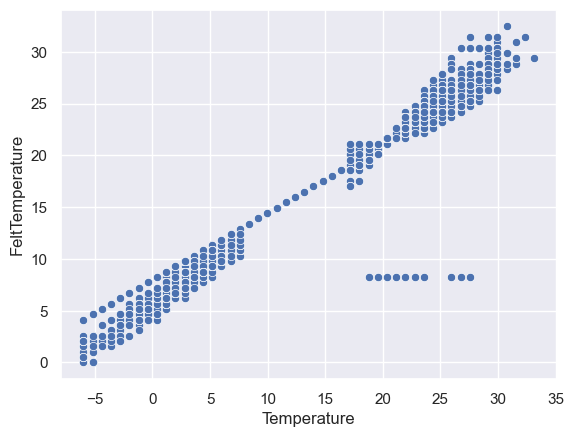

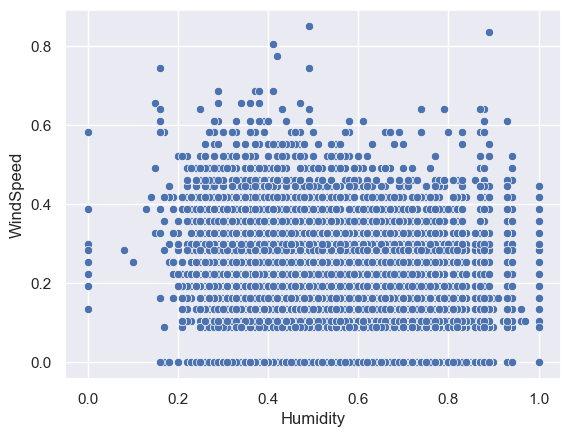

In [9]:
#AverageRideDurationPreviousDay_Min
sns.boxplot(data = data_raw, x= 'AverageRideDurationPreviousDay_Min')
plt.show()

sns.boxplot(data = data_raw, x= 'WeekofYear')
plt.show()

sns.scatterplot(x = 'Temperature', y = 'FeltTemperature', data = data_raw)
plt.show()

sns.scatterplot(x = 'Humidity', y = 'WindSpeed', data = data_raw)
plt.show()


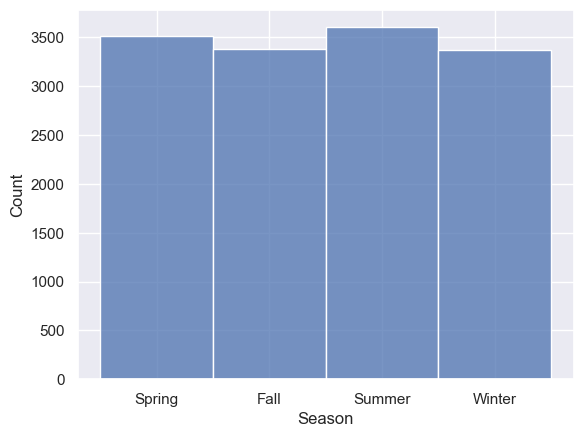

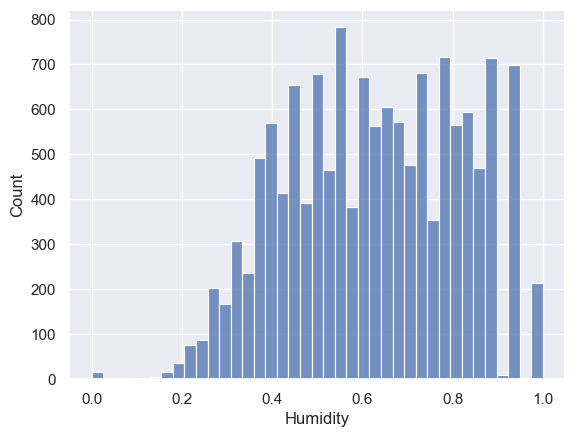

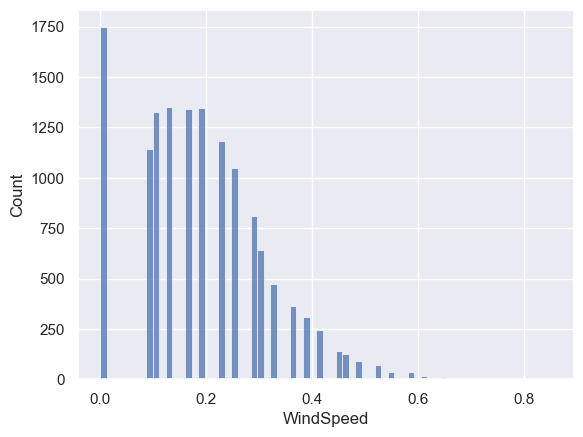

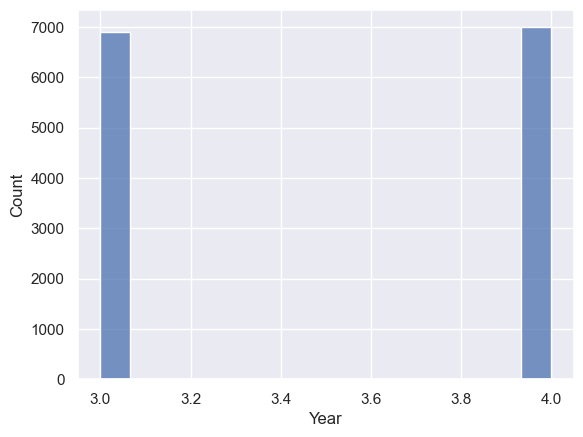

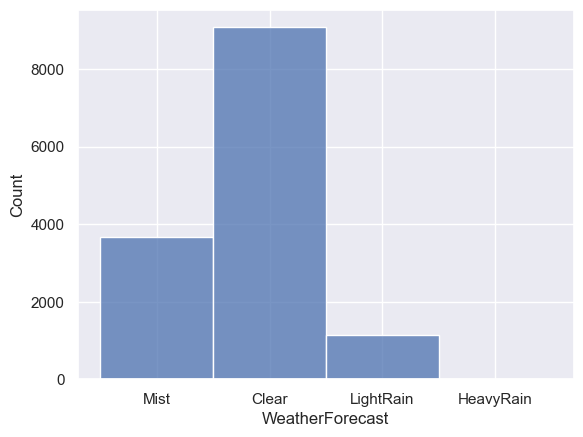

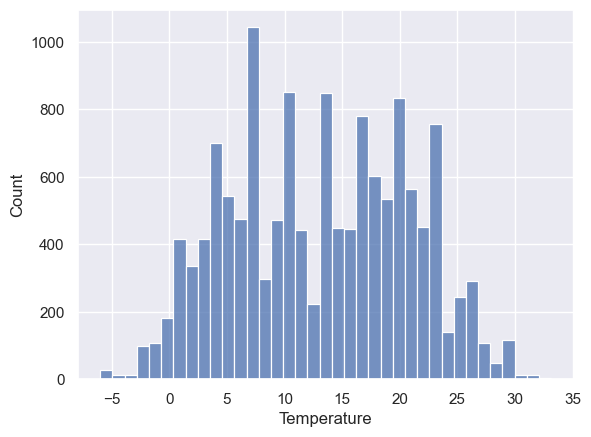

In [10]:
sns.histplot(data = data_raw, x= 'Season')
plt.show()

sns.histplot(data = data_raw, x= 'Humidity')
plt.show()

sns.histplot(data = data_raw, x= 'WindSpeed')
plt.show()

sns.histplot(data = data_raw, x= 'Year')
plt.show()



sns.histplot(data = data_raw, x= 'WeatherForecast')
plt.show()

sns.histplot(data = data_raw, x= 'Temperature')
plt.show()

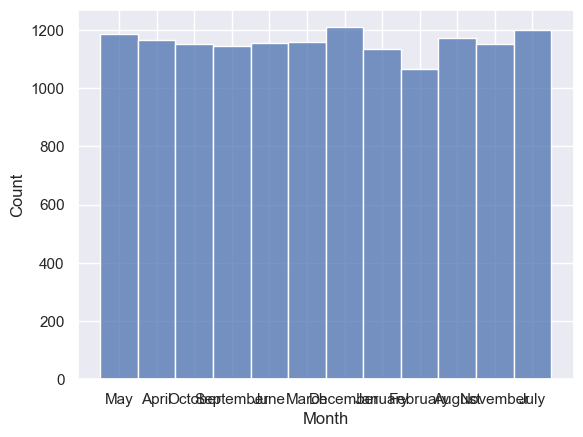

In [11]:
sns.histplot(data = data_raw, x= 'Month')
plt.show()

In [12]:
data_raw.describe()

,InstanceID,Year,HourofDay,Holiday,WorkingDay,Temperature,FeltTemperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,City_Detroit,WeekofYear,RidesBooked
count,13955.000000,13888.000000,13883.000000,13870.000000,13886.000000,13894.000000,13892.000000,13898.000000,13876.000000,13887.000000,13882.000000,13876.0,13888.000000,13955.000000
mean,55010.909137,3.503528,11.541742,0.029200,0.682558,13.075341,16.189178,0.626759,0.189967,15.637287,19.845969,1.0,26.659778,569.746972
std,26206.253028,0.500006,6.889074,0.168372,0.465498,7.722183,5.849787,0.192956,0.122566,8.757647,8.700009,0.0,15.017542,546.770205
min,10004.000000,3.000000,0.000000,0.000000,0.000000,-6.001000,0.000000,0.000000,0.000000,1.000000,5.001000,1.0,1.000000,3.000000
25%,32428.500000,3.000000,6.000000,0.000000,0.000000,6.783000,11.332200,0.470000,0.104500,8.000000,12.358250,1.0,14.000000,123.000000
50%,55083.000000,4.000000,12.000000,0.000000,1.000000,13.175000,16.483200,0.630000,0.194000,16.000000,19.711000,1.0,27.000000,429.000000
75%,77657.500000,4.000000,17.000000,0.000000,1.000000,19.567000,21.120800,0.780000,0.253700,23.000000,27.296500,1.0,40.000000,843.000000
max,99978.000000,4.000000,23.000000,1.000000,1.000000,33.150000,32.453000,1.000000,0.850700,31.000000,35.000000,1.0,52.000000,2931.000000


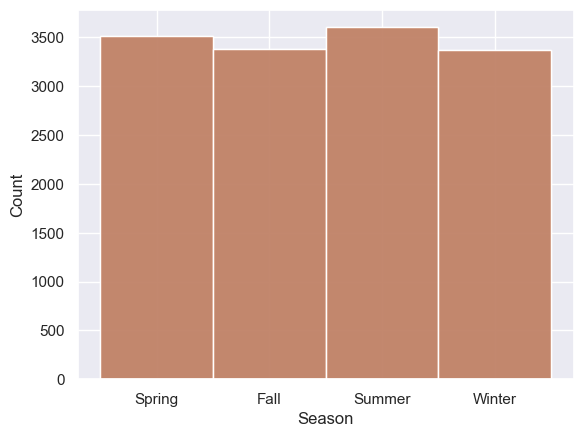

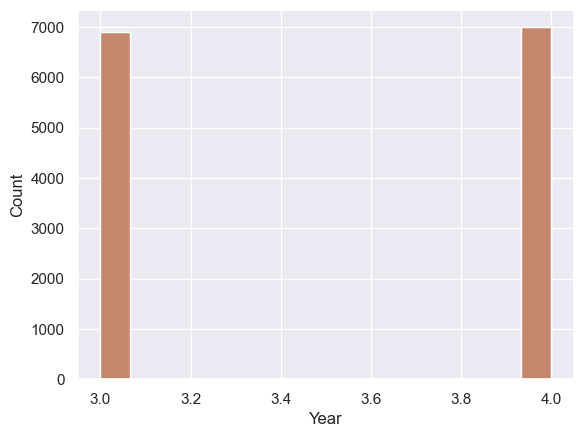

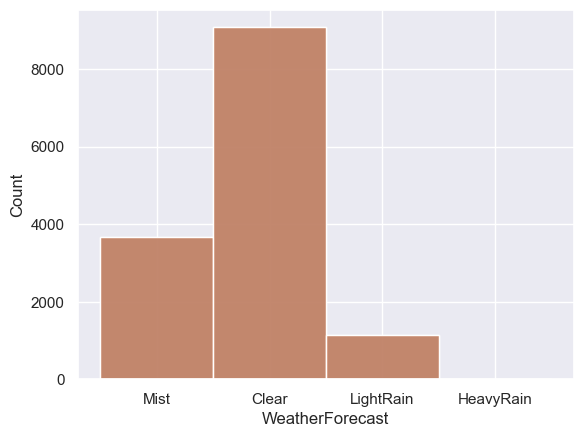

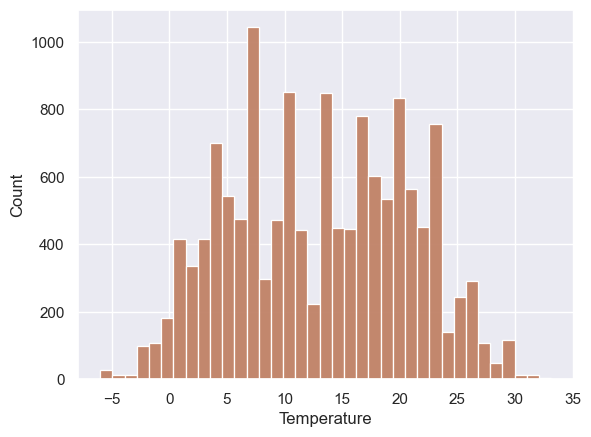

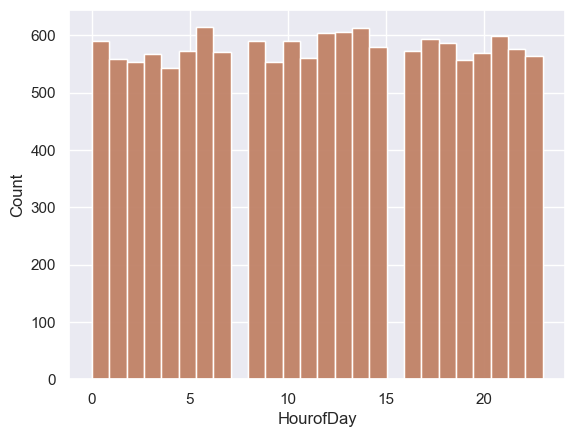

...

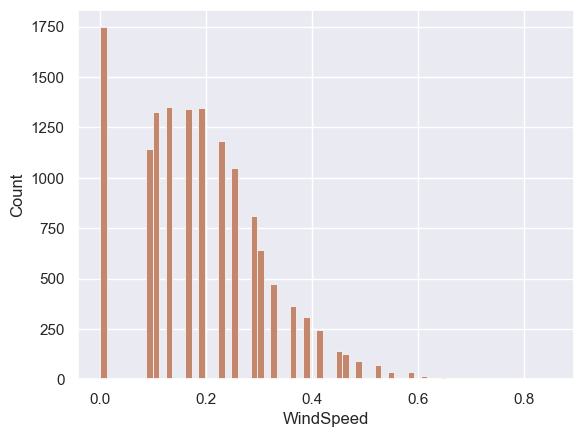

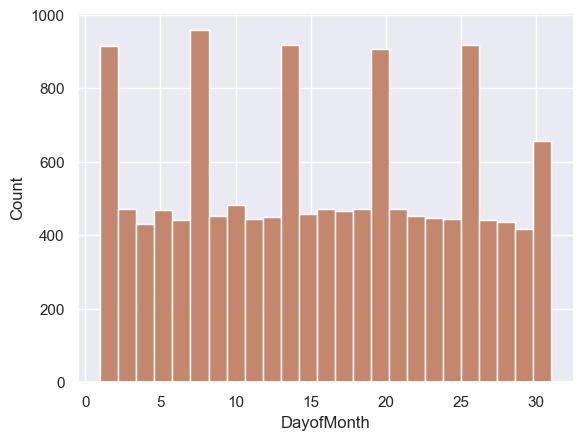

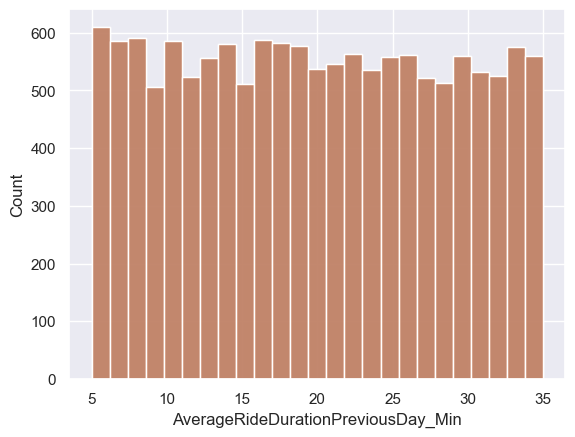

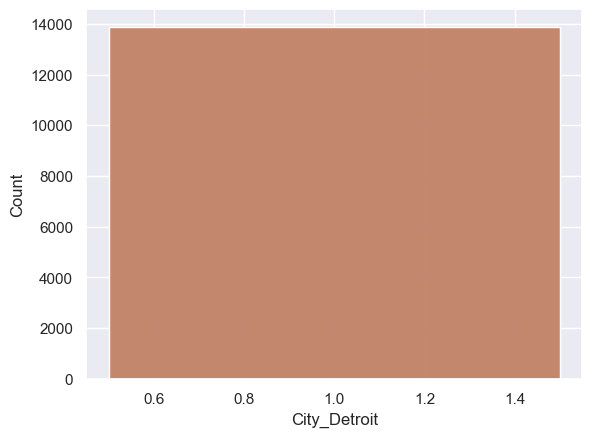

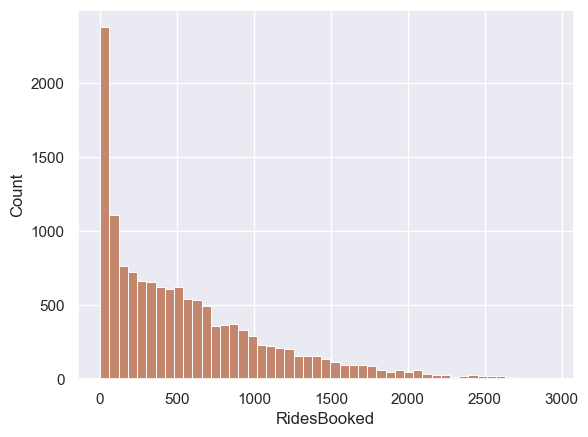

In [13]:
sns.histplot(data = data_raw, x='Season')
data= 'data_raw '
x='Season'
sns.histplot(data = data_raw, x= 'Season')
plt.show()

sns.histplot(data = data_raw, x='Year')
data= 'data_raw '
x='Year'
sns.histplot(data = data_raw, x= 'Year')
plt.show()


sns.histplot(data = data_raw, x='WeatherForecast')
data= 'data_raw '
x='WeatherForecast'
sns.histplot(data = data_raw, x= 'WeatherForecast')
plt.show()


sns.histplot(data = data_raw, x='Temperature')
data= 'data_raw '
x='Temperature'
sns.histplot(data = data_raw, x= 'Temperature')
plt.show()

sns.histplot(data = data_raw, x='HourofDay')
data= 'data_raw '
x='HourofDay'
sns.histplot(data = data_raw, x= 'HourofDay')
plt.show()

sns.histplot(data = data_raw, x='FeltTemperature')
data= 'data_raw '
x='FeltTemperature'
sns.histplot(data = data_raw, x= 'FeltTemperature')
plt.show()

#Humidity
sns.histplot(data = data_raw, x='Humidity')
data= 'data_raw '
x='Humidity'
sns.histplot(data = data_raw, x= 'Humidity')
plt.show()

sns.histplot(data = data_raw, x='WindSpeed')
data= 'data_raw '
x='WindSpeed'
sns.histplot(data = data_raw, x= 'WindSpeed')
plt.show()

sns.histplot(data = data_raw, x='DayofMonth')
data= 'data_raw '
x='DayofMonth'
sns.histplot(data = data_raw, x= 'DayofMonth')
plt.show()

#AverageRideDurationPreviousDay_Min
sns.histplot(data = data_raw, x='AverageRideDurationPreviousDay_Min')
data= 'data_raw '
x='AverageRideDurationPreviousDay_Min'
sns.histplot(data = data_raw, x= 'AverageRideDurationPreviousDay_Min')
plt.show()

#City_Detroit    
sns.histplot(data = data_raw, x='City_Detroit')
data= 'data_raw '
x='City_Detroit'
sns.histplot(data = data_raw, x= 'City_Detroit')
plt.show()

#RidesBooked 
sns.histplot(data = data_raw, x='RidesBooked')
data= 'data_raw '
x='RidesBooked'
sns.histplot(data = data_raw, x= 'RidesBooked')
plt.show()

In [14]:
#perform a very simple pairplot
g = sns.PairGrid(data_raw[numerical_features], height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

Text(0.5, 0.98, 'Relationship Between Variables')

In [15]:
data_raw.isna().sum()
#checking for missing values

InstanceID                             0
Season                                85
Year                                  67
Month                                 69
HourofDay                             72
Holiday                               85
DayofWeek                             68
WorkingDay                            69
WeatherForecast                       65
Temperature                           61
FeltTemperature                       63
Humidity                              57
WindSpeed                             79
DayofMonth                            68
AverageRideDurationPreviousDay_Min    73
City_Detroit                          79
WeekofYear                            67
RidesBooked                            0
dtype: int64

In [16]:
data_raw['InstanceID'].value_counts()
#checking the instanceid is there are any duplicated values - it is a unique identifier

21935    4
49181    4
12127    4
36913    4
33437    3
        ..
98952    1
90420    1
26422    1
43032    1
91835    1
Name: InstanceID, Length: 12686, dtype: int64

In [17]:
#validation data set - 20% of train data set
from sklearn.model_selection import train_test_split
train, val = train_test_split(data_raw,
                                    random_state = 15, #define specific shuffle of data
                                    test_size = 0.2)

#now we will use the train set to train the data
#then validation set to check if our model is good - everything that we do to train dataset we also need to do to validation dataset
#validation dataset IS NOT a test dataset

<a class="anchor" id="">

# 3. Modify data (Data preparation)

</a>

## Delete outliers and duplicates raw


In [18]:
train.shape

(11164, 18)

In [19]:
def remove_outlier(df_in, col_name):
    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    #print (df_in[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)].shape)
    df_out = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
    return df_out

In [20]:
def error_outlier(df_in, col_name):
    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_in[col_name].replace(0, np.nan, inplace=True)
    #df_in[col_name]= np.where((df_in[col_name] < fence_low) & (df_in[col_name] > fence_high), np.nan, df_in[col_name])
    #print (df_in[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)].shape)
    return df_in

In [21]:
train = remove_outlier(train,'WindSpeed')
train = error_outlier(train,'Humidity')

In [22]:
train.isna().sum()

InstanceID                             0
Season                                67
Year                                  51
Month                                 58
HourofDay                             52
Holiday                               72
DayofWeek                             50
WorkingDay                            54
WeatherForecast                       50
Temperature                           51
FeltTemperature                       53
Humidity                              56
WindSpeed                              0
DayofMonth                            57
AverageRideDurationPreviousDay_Min    62
City_Detroit                          58
WeekofYear                            47
RidesBooked                            0
dtype: int64

In [23]:
data_raw = remove_outlier(data_raw,'WindSpeed')
data_raw = error_outlier(data_raw,'Humidity')

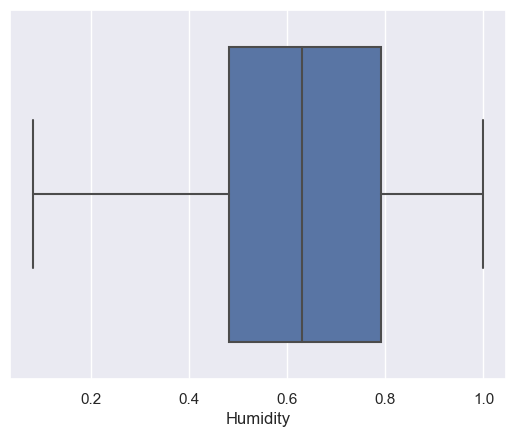

In [24]:
sns.boxplot(data = train, x= 'Humidity')
plt.show()

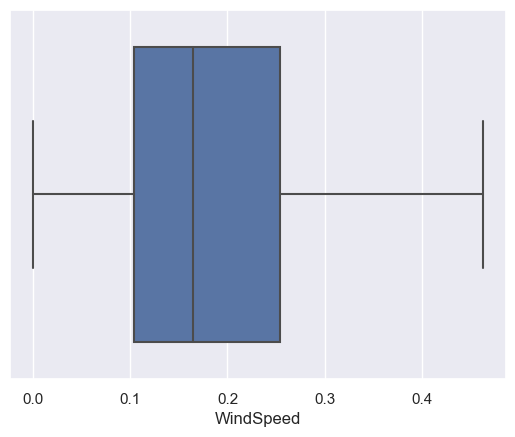

In [25]:
sns.boxplot(data = train, x= 'WindSpeed')
plt.show()

In [26]:
train.shape

(10875, 18)

In [27]:
#delete duplicates raw
#val = val.drop_duplicates()
train = train.drop_duplicates()
#test_raw = test_raw.drop_duplicates()
data_raw = data_raw.drop_duplicates()

In [28]:
train.shape

(10049, 18)

#### Fill missing value

In [29]:
def Season_fill(data, nome_coloumn_season, nome_coloumn_month,nome_coloumn_day):
    #data = data.fillna(0)
    #print(data[data[nome_coloumn_season].isna()].shape)
    #print(data[data[nome_coloumn_season].isna()].shape)
    data.loc[(data[nome_coloumn_season].isna()) & ((data[nome_coloumn_month] == "January") | (data[nome_coloumn_month] == "February")) , nome_coloumn_season] = 'Winter'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "March") & (data[nome_coloumn_day] <= 21) , nome_coloumn_season] = 'Winter'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "March") & (data[nome_coloumn_day] > 21) , nome_coloumn_season] = 'Spring'
    data.loc[(data[nome_coloumn_season].isna()) & ((data[nome_coloumn_month] == "April") | (data[nome_coloumn_month] == "May")) , nome_coloumn_season] = 'Spring'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "June") & (data[nome_coloumn_day] <= 21) , nome_coloumn_season] = 'Spring'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "June") & (data[nome_coloumn_day] > 21) , nome_coloumn_season] = 'Summer'
    data.loc[(data[nome_coloumn_season].isna()) & ((data[nome_coloumn_month] == "July") | (data[nome_coloumn_month] == "August")) , nome_coloumn_season] = 'Summer'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "September") & (data[nome_coloumn_day] <= 21) , nome_coloumn_season] = 'Summer'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "September") & (data[nome_coloumn_day] > 21) , nome_coloumn_season] = 'Fall'
    data.loc[(data[nome_coloumn_season].isna()) & ((data[nome_coloumn_month] == "October") | (data[nome_coloumn_month] == "November")) , nome_coloumn_season] = 'Fall'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "December") & (data[nome_coloumn_day] <= 21) , nome_coloumn_season] = 'Fall'
    data.loc[(data[nome_coloumn_season].isna()) & (data[nome_coloumn_month] == "December") & (data[nome_coloumn_day] > 21) , nome_coloumn_season] = 'Winter'
    #print(data[data[nome_coloumn_season]== 0].shape)
    #print(data[data[nome_coloumn_season].isna()].shape)
    return data

In [30]:
train = Season_fill(train,"Season","Month","DayofMonth")
val = Season_fill(val,"Season","Month","DayofMonth")
mode = train["Season"].mode()
val["Season"] = val["Season"].fillna(value=mode)

In [31]:
data_raw = Season_fill(data_raw,"Season","Month","DayofMonth")
test_raw = Season_fill(test_raw,"Season","Month","DayofMonth")

mode = data_raw["Season"].mode()
test_raw["Season"] = test_raw["Season"].fillna(value=mode)

In [32]:
def fill_day_month(Data,nome_coloumn_DayMonth,nome_coloumn_year,nome_coloumn_DayofWeek,nome_coloumn_weekoftheyear):
    Data[nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth].fillna(0)
    Data[nome_coloumn_DayofWeek] = Data[nome_coloumn_DayofWeek].fillna(0)

    def set_values(row, value):
        return value[row]

    year_3 ={0 : 0 ,
         "Saturday" : 1,
         "Sunday" : 2,
         "Monday" : 3,
         "Tuesday" : 4,
         "Wednesday" : 5,
         "Thursday" : 6,
         "Friday" : 7         
        }

    year_4 ={0  : 0,
         "Saturday" : 7,
         "Sunday" : 1,
         "Monday" : 2,
         "Tuesday" : 3,
         "Wednesday" : 4,
         "Thursday" : 5,
         "Friday" : 6         
        }

    Data["year_3"] = Data[nome_coloumn_DayofWeek].apply(set_values, args =(year_3,))
    Data["year_4"] = Data[nome_coloumn_DayofWeek].apply(set_values, args =(year_4,))
    Data["new"] = np.where(Data[nome_coloumn_year] == 3.0,Data["year_3"],Data["year_4"])
    Data.loc[(Data[nome_coloumn_year] == 4) & (Data["new"] == 91)] = 29
    Data.loc[(Data[nome_coloumn_year] == 4) & (Data["new"] > 91)] = Data["new"]-1
    Data["new"] =  (Data[nome_coloumn_weekoftheyear]-1) * 7 + Data["new"]
    Data.loc[Data[nome_coloumn_DayMonth] == 0,nome_coloumn_DayMonth] = Data["new"]
    Data.loc[(Data[nome_coloumn_DayMonth] > 31) & (Data[nome_coloumn_DayMonth] <= 59) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -31
    Data.loc[(Data[nome_coloumn_DayMonth] > 59) & (Data[nome_coloumn_DayMonth] <= 90),nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -59
    Data.loc[(Data[nome_coloumn_DayMonth] > 90) & (Data[nome_coloumn_DayMonth] <= 120),nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -90
    Data.loc[(Data[nome_coloumn_DayMonth] > 120) & (Data[nome_coloumn_DayMonth] <= 151),nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -120
    Data.loc[(Data[nome_coloumn_DayMonth] > 151) & (Data[nome_coloumn_DayMonth] <= 181) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -151
    Data.loc[(Data[nome_coloumn_DayMonth] > 181) & (Data[nome_coloumn_DayMonth] <= 212) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -181
    Data.loc[(Data[nome_coloumn_DayMonth] > 212) & (Data[nome_coloumn_DayMonth] <= 243) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -212
    Data.loc[(Data[nome_coloumn_DayMonth] > 243) & (Data[nome_coloumn_DayMonth] <= 273) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -243
    Data.loc[(Data[nome_coloumn_DayMonth] > 273) & (Data[nome_coloumn_DayMonth] <= 304) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -273
    Data.loc[(Data[nome_coloumn_DayMonth] > 304) & (Data[nome_coloumn_DayMonth] <= 334) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -304
    Data.loc[(Data[nome_coloumn_DayMonth] > 334) & (Data[nome_coloumn_DayMonth] <= 366) ,nome_coloumn_DayMonth] = Data[nome_coloumn_DayMonth] -334
    
    Data[nome_coloumn_DayofWeek].replace(0, np.nan, inplace=True)
    
    del Data["year_4"]
    del Data["year_3"]
    del Data["new"] 
    return Data

In [33]:
train = fill_day_month(train,"DayofMonth","Year","DayofWeek","WeekofYear")
val = fill_day_month(val,"DayofMonth","Year","DayofWeek","WeekofYear")

In [34]:
mode = train["DayofMonth"].mode()
train["DayofMonth"] = train["DayofMonth"].fillna(value=15)
val["DayofMonth"] = val["DayofMonth"].fillna(value=15)

In [35]:
test_raw = fill_day_month(test_raw,"DayofMonth","Year","DayofWeek","WeekofYear")
data_raw = fill_day_month(data_raw,"DayofMonth","Year","DayofWeek","WeekofYear")

In [36]:
mode = train["DayofMonth"].mode()
data_raw["DayofMonth"] = data_raw["DayofMonth"].fillna(value=15)
test_raw["DayofMonth"] = test_raw["DayofMonth"].fillna(value=15)

In [37]:
test_raw["DayofMonth"]=test_raw["DayofMonth"].fillna(value=15)

### Categorical to numerical

In [38]:
# converted days to numerical just to calculate month values   
    
train['DayofWeek'].replace([
     "Monday",                           
     "Tuesday",
     "Wednesday",
     "Thursday",
     "Friday",
     "Saturday",
     "Sunday"],[1,2,3,4,5,6,7], inplace=True)

val['DayofWeek'].replace([
     "Monday",                           
     "Tuesday",
     "Wednesday",
     "Thursday",
     "Friday",
     "Saturday",
     "Sunday"],[1,2,3,4,5,6,7], inplace=True)

test_raw['DayofWeek'].replace([
     "Monday",                           
     "Tuesday",
     "Wednesday",
     "Thursday",
     "Friday",
     "Saturday",
     "Sunday"],[1,2,3,4,5,6,7], inplace=True)

data_raw['DayofWeek'].replace([
     "Monday",                           
     "Tuesday",
     "Wednesday",
     "Thursday",
     "Friday",
     "Saturday",
     "Sunday"],[1,2,3,4,5,6,7], inplace=True)

In [39]:
#changing the months to numerical
def convert_month_to_numerical(df):
    month_dict = {np.nan:np.nan,'January': 1, 'February': 2, 'March': 3, 'April': 4, 'May': 5, 'June': 6, 
                  'July': 7, 'August': 8, 'September': 9, 'October': 10, 'November': 11, 'December': 12}
    df['Month'] = df['Month'].apply(lambda x: month_dict[x])
    return df

In [40]:
train = convert_month_to_numerical(train)

In [41]:
val = convert_month_to_numerical(val)

In [42]:
test_raw = convert_month_to_numerical(test_raw)

In [43]:
val

,InstanceID,Season,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,WeatherForecast,Temperature,FeltTemperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,City_Detroit,WeekofYear,RidesBooked
13933,85247,Fall,4.0,12.0,23.0,0.0,2.0,1.0,Clear,12.376,15.9698,0.67,0.2537,4.0,6.208,1.0,49.0,288
12592,31004,Fall,3.0,10.0,16.0,1.0,1.0,0.0,Mist,21.165,21.6376,0.45,0.0896,10.0,23.646,1.0,41.0,1206
1926,20401,Summer,4.0,8.0,9.0,0.0,1.0,1.0,Mist,18.768,20.6074,0.69,0.0000,20.0,5.676,1.0,34.0,1071
2088,68270,Summer,4.0,8.0,8.0,0.0,5.0,1.0,Clear,21.964,23.1812,0.70,0.1343,3.0,21.335,1.0,31.0,2004
4394,16322,Fall,4.0,11.0,22.0,1.0,4.0,0.0,Clear,5.984,11.8490,0.61,0.0000,22.0,34.941,1.0,47.0,132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8804,71465,Winter,4.0,1.0,2.0,0.0,4.0,1.0,LightRain,7.582,11.8490,0.93,0.2537,12.0,5.492,1.0,2.0,6
9304,57158,Spring,4.0,5.0,21.0,1.0,1.0,0.0,Clear,23.562,24.7282,0.66,0.2836,28.0,20.621,1.0,22.0,741
11124,95600,Winter,3.0,3.0,20.0,0.0,3.0,1.0,Clear,7.582,11.3322,0.29,0.4179,2.0,9.647,1.0,9.0,285
6231,26628,Fall,3.0,11.0,21.0,1.0,4.0,0.0,Clear,7.582,11.8490,0.71,0.1642,24.0,21.897,1.0,47.0,78


In [44]:
data_raw = convert_month_to_numerical(data_raw)

In [45]:
train.isna().sum()

InstanceID                             0
Season                                 0
Year                                  49
Month                                 57
HourofDay                             46
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                          52
WeekofYear                            44
RidesBooked                            0
dtype: int64

In [46]:
data_raw.isna().sum()

InstanceID                             0
Season                                 0
Year                                  63
Month                                 67
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                            56
RidesBooked                            0
dtype: int64

In [47]:
data_raw.isna().sum()

InstanceID                             0
Season                                 0
Year                                  63
Month                                 67
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                            56
RidesBooked                            0
dtype: int64

In [48]:
#KNN imputer for solve month
prova = train[["DayofWeek","DayofMonth","Month","Year"]].copy()
    
    
    
imputer = KNNImputer(n_neighbors=1)

imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = train.index)

    
train["Month"] = df_imputed["Month"]

prova = val[["DayofWeek","DayofMonth","Month","Year"]].copy()
val_new = imputer.transform(prova)
df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = val.index)

    
val["Month"] = df_val_imputed["Month"]
val.loc[val["Year"]== 0,"DayofWeek"] =np.nan


prova = data_raw[["DayofWeek","DayofMonth","Month","Year"]].copy()
imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = data_raw.index)
data_raw["Month"] = df_imputed["Month"]

prova = test_raw[["DayofWeek","DayofMonth","Month","Year"]].copy()
test_raw_new = imputer.transform(prova)
df_test_raw_imputed = pd.DataFrame(test_raw_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = test_raw.index)

    
test_raw["Month"] = df_test_raw_imputed["Month"]

In [49]:
data_Kfold = data_raw.copy()


In [50]:
data_Kfold.isna().sum()

InstanceID                             0
Season                                 0
Year                                  63
Month                                  0
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                            56
RidesBooked                            0
dtype: int64

In [51]:
train.isna().sum()

InstanceID                             0
Season                                 0
Year                                  49
Month                                  0
HourofDay                             46
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                          52
WeekofYear                            44
RidesBooked                            0
dtype: int64

In [52]:
#KNN imputer for solve year
prova = train[["DayofWeek","DayofMonth","Month","Year"]].copy()
    
    
    
imputer = KNNImputer(n_neighbors=1)

imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = train.index)

    
train["Year"] = df_imputed["Year"]

prova = val[["DayofWeek","DayofMonth","Month","Year"]].copy()
val_new = imputer.transform(prova)
df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = val.index)

    
val["Year"] = df_val_imputed["Year"]
val.loc[val["Year"]== 0,"DayofWeek"] =np.nan


prova = data_raw[["DayofWeek","DayofMonth","Month","Year"]].copy()
imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = data_raw.index)
data_raw["Year"] = df_imputed["Year"]

prova = test_raw[["DayofWeek","DayofMonth","Month","Year"]].copy()
test_raw_new = imputer.transform(prova)
df_test_raw_imputed = pd.DataFrame(test_raw_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = test_raw.index)

    
test_raw["Year"] = df_test_raw_imputed["Year"]



In [53]:
#if there is a problem in the functon I have to fill in someway the missing value in this case we decide to change with the mode.
mode = train["Year"].mode()
train["Year"] = train["Year"].fillna(value=mode)
val["Year"] = val["Year"].fillna(value=mode)


mode = data_raw["Year"].mode()
data_raw["Year"] = data_raw["Year"].fillna(value=mode)
test_raw["Year"] = test_raw["Year"].fillna(value=mode)

In [54]:
data_raw.isna().sum()

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                            56
RidesBooked                            0
dtype: int64

In [55]:
train.isna().sum()

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                             46
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                          52
WeekofYear                            44
RidesBooked                            0
dtype: int64

In [56]:
def fill_weekofyear(Data,month,year,day,weekofyear):
    month1 = [31,28,31,30,31,30,31,31,30,31,30,31]
    month2 = [31,29,31,30,31,30,31,31,30,31,30,31]
    y1=[31]
    y2=[31]
    for i in range(1, len(month1)):
        y1.append(month1[i]+y1[i-1])
    
    y1
    for i in range(1, len(month2)):
        y2.append(month2[i]+y2[i-1])
    
    y2
    y_1 = { i+1 : y1[i] for i in range(len(y1)) }
    y_2 = { i+1 : y2[i] for i in range(len(y2)) }
    Data['Help'] = Data[month].map(y_1)
    Data['Help2'] = Data[month].map(y_2)
    Data['Help'] = Data['Help'] + Data[day]
    Data['Help2'] = Data['Help2'] + Data[day]
    Data.loc[(Data[weekofyear].isna())&(Data[year]==3), weekofyear] = Data['Help'].apply(lambda x: x //7 ) 
    Data.loc[(Data[weekofyear].isna())&(Data[year]==4), weekofyear] = Data['Help2'].apply(lambda x: x //7 )
    del Data["Help2"]
    del Data["Help"]
 

    return Data

In [57]:
train = fill_weekofyear(train,"Month","Year","DayofMonth","WeekofYear")

val = fill_weekofyear(val,"Month","Year","DayofMonth","WeekofYear")

test_raw = fill_weekofyear(test_raw,"Month","Year","DayofMonth","WeekofYear")

data_raw = fill_weekofyear(data_raw,"Month","Year","DayofMonth","WeekofYear")

In [58]:
mode = train["WeekofYear"].mode()
val["WeekofYear"] = val["WeekofYear"].fillna(value=mode)


mode = data_raw["WeekofYear"].mode()
test_raw["WeekofYear"] = test_raw["WeekofYear"].fillna(value=mode)

In [59]:
data_raw.isna().sum()

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                             0
RidesBooked                            0
dtype: int64

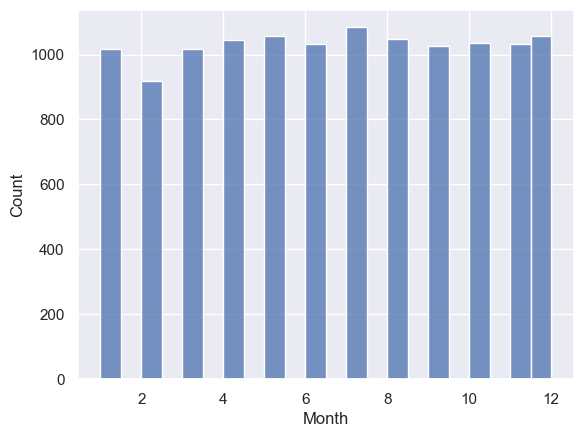

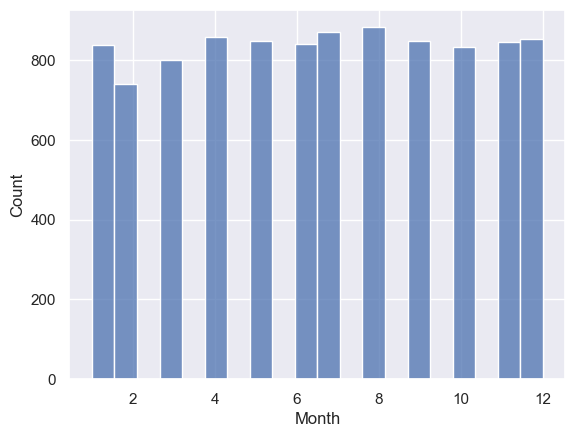

In [60]:
sns.histplot(data = data_raw, x= 'Month')
plt.show()
sns.histplot(data = train, x= 'Month')
plt.show()

In [61]:
train['Month'].value_counts()

8.0     882
7.0     870
4.0     858
12.0    853
5.0     848
9.0     848
11.0    844
6.0     839
1.0     837
10.0    832
3.0     799
2.0     739
Name: Month, dtype: int64

In [62]:
train['DayofMonth'].value_counts()

1.0     356
15.0    347
10.0    347
21.0    341
7.0     339
17.0    339
3.0     338
6.0     337
24.0    337
26.0    336
20.0    336
16.0    335
5.0     333
8.0     332
22.0    332
9.0     330
23.0    329
25.0    328
4.0     327
13.0    326
18.0    322
11.0    321
14.0    320
12.0    319
2.0     317
19.0    313
28.0    310
27.0    307
29.0    307
30.0    293
31.0    195
Name: DayofMonth, dtype: int64

In [63]:
#creating a time line
def Date(Data,day,month,year):
    month1 = [31,28,31,30,31,30,31,31,30,31,30,31]
    month2 = [31,29,31,30,31,30,31,31,30,31,30,31]
    y1=[31]
    y2=[31]
    for i in range(1, len(month1)):
        y1.append(month1[i]+y1[i-1])
    
    y1
    for i in range(1, len(month2)):
        y2.append(month2[i]+y2[i-1])
    
    y2

    y_1 = { i+1 : y1[i] for i in range(len(y1)) }
    #print(y_1)
    y_2 = { i+1 : y2[i] for i in range(len(y2)) }
    #print(y_2)
    #print(Data[day].isna().sum())
    Data['Help'] = Data[month].map(y_1)
    Data['Help2'] = Data[month].map(y_2)
    #print(Data['Help2'].isna().sum())
    #print(Data['Help'].isna().sum())
    Data['Help'] = Data['Help'] + Data[day]
    Data['Help2'] = Data['Help2'] + Data[day]
    #print(Data['Help2'].isna().sum())
    #print(Data['Help'].isna().sum())
    Data['Difference year'] = Data[year]-3
    Data.loc[Data['Difference year']==0, 'Date'] = Data['Help']
    Data.loc[Data['Difference year']==1, 'Date'] = Data['Help2'] +365
    #print(Data['Help2'].isna().sum())
    #print(Data['Help'].isna().sum())
    #print(Data['Difference year'].isna().sum())
    #print(Data['Date'].isna().sum())
    
    
    
    del Data['Help2']
    del Data['Help']
    del Data['Difference year']

    
    return Data
    


In [64]:
train = Date(train,'DayofMonth','Month','Year')

val = Date(val,'DayofMonth','Month','Year')

data_raw = Date(data_raw,'DayofMonth','Month','Year')

test_raw = Date(test_raw,'DayofMonth','Month','Year')

In [65]:
data_raw.isna().sum()

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                             58
Holiday                               71
DayofWeek                             64
WorkingDay                            63
WeatherForecast                       60
Temperature                           54
FeltTemperature                       55
Humidity                              67
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    69
City_Detroit                          64
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [66]:
train.isna().sum()
#checking for missing values

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                             46
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                          52
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [67]:
### Missing values for "HourofDay"


s_t=pd.get_dummies(train[["Season","Temperature","HourofDay"]])
s_data_raw = pd.get_dummies(data_raw[["Season","Temperature","HourofDay"]])
s_t_v=pd.get_dummies(val[["Season","Temperature","HourofDay"]])
s_t_t=pd.get_dummies(test[["Season","Temperature","HourofDay"]])
s_t.isna().sum()

imputer = KNNImputer()
imputer.fit(s_t)
new_s_t = imputer.transform(s_t)
new_s_t_v = imputer.transform(s_t_v)

train["HourofDay"]=pd.DataFrame(new_s_t,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values
val["HourofDay"]=pd.DataFrame(new_s_t_v,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values

imputer.fit(s_data_raw)
new_s_data_raw = imputer.transform(s_data_raw)
new_s_t_t = imputer.transform(s_t_t)

data_raw["HourofDay"]=pd.DataFrame(new_s_data_raw,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values
test_raw["HourofDay"]=pd.DataFrame(new_s_t_t,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values


In [68]:
#if there is a problem in the functon I have to fill in someway the missing value in this case we decide to change with the mode.
mode = train["HourofDay"].mode()
val["HourofDay"] = val["HourofDay"].fillna(value=mode)
train["HourofDay"] = train["HourofDay"].fillna(value=mode)


mode = data_raw["HourofDay"].mode()
data_raw["HourofDay"] = data_raw["HourofDay"].fillna(value=mode)
test_raw["HourofDay"] = test_raw["HourofDay"].fillna(value=mode)

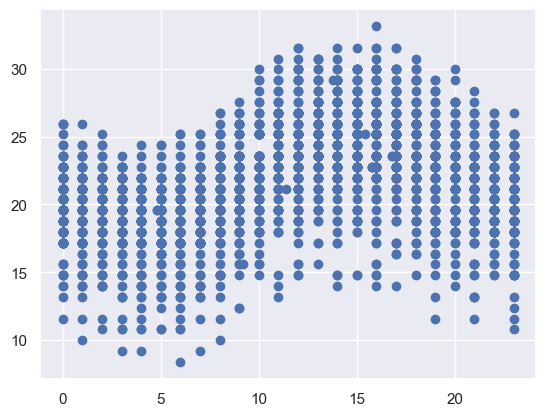

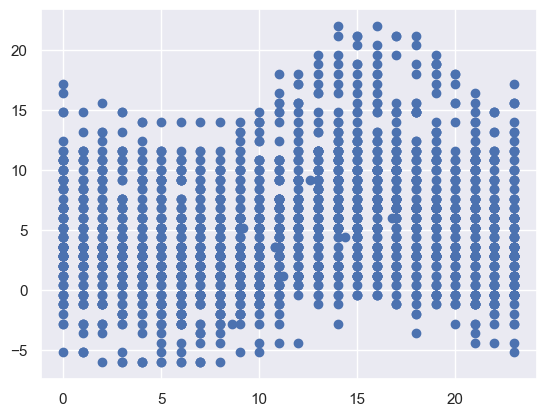

In [69]:
#Checking correlation between hour of day adn temperature for two different seasons
just_summer=train[train["Season"]=="Summer"]

plt.scatter(just_summer["HourofDay"],just_summer["Temperature"])
plt.show()

just_summer=train[train["Season"]=="Winter"]

plt.scatter(just_summer["HourofDay"],just_summer["Temperature"])
plt.show()


In [70]:
just_summer["Temperature"].corr(just_summer["HourofDay"])
# it is not a strong correlation actually


0.18552961453805944

In [71]:
train.isna().sum()

InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                              0
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                          52
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [72]:
val.isna().sum()


InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                              0
Holiday                               11
DayofWeek                             18
WorkingDay                            13
WeatherForecast                       15
Temperature                           10
FeltTemperature                        9
Humidity                              11
WindSpeed                             17
DayofMonth                             0
AverageRideDurationPreviousDay_Min    11
City_Detroit                          16
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [73]:
def city_fill(data, nome_coloumn_city):
    data.loc[data[nome_coloumn_city].isna(), nome_coloumn_city] = 1.0
    return data

In [74]:
train = city_fill(train, "City_Detroit")
val = city_fill(val, "City_Detroit")

In [75]:
test_raw = city_fill(test_raw, "City_Detroit")
data_raw = city_fill(data_raw, "City_Detroit")

In [76]:
train.isna().sum()


InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                              0
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                           0
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [77]:
train.isna().sum()


InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                              0
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                       48
Temperature                           45
FeltTemperature                       48
Humidity                              54
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min    60
City_Detroit                           0
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [78]:
#Fill missing value Temperature
train["Help"]=train["Temperature"]-train["FeltTemperature"]
grouped=train.groupby('Date')['Help'].mean().to_dict()
grouped[np.nan]=np.nan
train["Help2"] = train['Date'].map(grouped)
train.loc[train['Temperature'].isna(), 'Temperature'] = train["FeltTemperature"] + train["Help2"]
del train["Help2"]
del train["Help"]

val["Help"]=val['Temperature']-val["FeltTemperature"]
val["Help2"] = val['Date'].map(grouped)
val.loc[val['Temperature'].isna(), 'Temperature'] = val["FeltTemperature"] + val["Help2"]
del val["Help2"]
del val["Help"]

#if there is a problem in the map I have to fill in someway the missing value
mean_value=train['Temperature'].median()
val['Temperature'].fillna(value=mean_value, inplace=True)

data_raw["Help"]=data_raw["Temperature"]-data_raw["FeltTemperature"]
grouped=data_raw.groupby('Date')['Help'].mean().to_dict()
grouped[np.nan]=np.nan
data_raw["Help2"] = data_raw['Date'].map(grouped)
data_raw.loc[data_raw['Temperature'].isna(), 'Temperature'] = data_raw["FeltTemperature"] + data_raw["Help2"]
del data_raw["Help2"]
del data_raw["Help"]


test_raw["Help"]=test_raw['Temperature']-test_raw["FeltTemperature"]
test_raw["Help2"] = test_raw['Date'].map(grouped)
test_raw.loc[test_raw['Temperature'].isna(), 'Temperature'] = test_raw["FeltTemperature"] + test_raw["Help2"]
del test_raw["Help2"]
del test_raw["Help"]

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['Temperature'].median()
test_raw['Temperature'].fillna(value=mean_value, inplace=True)

In [79]:
#Fill missing value FeltTemperature
train["Help"]=train['Temperature']-train["FeltTemperature"]
grouped=train.groupby('Date')['Help'].mean().to_dict()
grouped[np.nan]=np.nan
train["Help2"] = train['Date'].map(grouped)
train.loc[train["FeltTemperature"].isna(), "FeltTemperature"] = train['Temperature'] - train["Help2"]
del train["Help2"]
del train["Help"]

val["Help"]=val['Temperature']-val["FeltTemperature"]
val["Help2"] = val['Date'].map(grouped)
val.loc[val["FeltTemperature"].isna(), "FeltTemperature"] = val['Temperature'] - val["Help2"]
del val["Help2"]
del val["Help"]

#if there is a problem in the map I have to fill in someway the missing value
mean_value=train['FeltTemperature'].median()
val['FeltTemperature'].fillna(value=mean_value, inplace=True)

data_raw["Help"]=data_raw["FeltTemperature"]-data_raw["Temperature"]
grouped=data_raw.groupby('Date')['Help'].mean().to_dict()
grouped[np.nan]=np.nan
data_raw["Help2"] = data_raw['Date'].map(grouped)
data_raw.loc[data_raw['FeltTemperature'].isna(), 'FeltTemperature'] = data_raw["Temperature"] + data_raw["Help2"]
del data_raw["Help2"]
del data_raw["Help"]

test_raw["Help"]=test_raw['Temperature']-test_raw["FeltTemperature"]
test_raw["Help2"] = test_raw['Date'].map(grouped)
test_raw.loc[test_raw["FeltTemperature"].isna(), "FeltTemperature"] = test_raw['Temperature'] - test_raw["Help2"]
del test_raw["Help2"]
del test_raw["Help"]

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['Temperature'].median()
test_raw['Temperature'].fillna(value=mean_value, inplace=True)

In [80]:
# missing values for WindSpeed
grouped =train.groupby('Date')['WindSpeed'].median().to_dict()
grouped[np.nan]=np.nan
train['WindSpeed'] = train['WindSpeed'].fillna(train['Date'].map(grouped))
val['WindSpeed'] = val['WindSpeed'].fillna(val['Date'].map(grouped))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=train['WindSpeed'].median()
val['WindSpeed'].fillna(value=mean_value, inplace=True)


grouped =data_raw.groupby('Date')['WindSpeed'].median().to_dict()
grouped[np.nan]=np.nan
test_raw['WindSpeed'] = test_raw['WindSpeed'].fillna(test_raw['Date'].map(grouped))
data_raw['WindSpeed'] = data_raw['WindSpeed'].fillna(data_raw['Date'].map(grouped))


#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['WindSpeed'].median()
test_raw['WindSpeed'].fillna(value=mean_value, inplace=True)


In [81]:
#AverageRideDurationPreviousDay_Min mean of each day
grouped =train.groupby('Date')['AverageRideDurationPreviousDay_Min'].median().to_dict()
grouped[np.nan]=np.nan
train['AverageRideDurationPreviousDay_Min'] = train['AverageRideDurationPreviousDay_Min'].fillna(train['Date'].map(grouped))
val['AverageRideDurationPreviousDay_Min'] = val['AverageRideDurationPreviousDay_Min'].fillna(val['Date'].map(grouped))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=train['AverageRideDurationPreviousDay_Min'].median()
val['AverageRideDurationPreviousDay_Min'].fillna(value=mean_value, inplace=True)


grouped =data_raw.groupby('Date')['AverageRideDurationPreviousDay_Min'].median().to_dict()
grouped[np.nan]=np.nan
test_raw['AverageRideDurationPreviousDay_Min'] = test_raw['AverageRideDurationPreviousDay_Min'].fillna(test_raw['Date'].map(grouped))
data_raw['AverageRideDurationPreviousDay_Min'] = data_raw['AverageRideDurationPreviousDay_Min'].fillna(data_raw['Date'].map(grouped))


#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['AverageRideDurationPreviousDay_Min'].median()
test_raw['AverageRideDurationPreviousDay_Min'].fillna(value=mean_value, inplace=True)

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['AverageRideDurationPreviousDay_Min'].median()
data_raw['AverageRideDurationPreviousDay_Min'].fillna(value=mean_value, inplace=True)

In [82]:
#fill Humidity
grouped=train.groupby('Date')['Humidity'].median().to_dict()
grouped[np.nan]=np.nan
train['Humidity'] = train['Humidity'].fillna(train['Date'].map(grouped))
val['Humidity'] = val['Humidity'].fillna(val['Date'].map(grouped))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=train['Humidity'].median()
val['Humidity'].fillna(value=mean_value, inplace=True)
train['Humidity'].fillna(value=mean_value, inplace=True)

grouped=data_raw.groupby('Date')['Humidity'].median().to_dict()
grouped[np.nan]=np.nan
data_raw['Humidity'] = data_raw['Humidity'].fillna(data_raw['Date'].map(grouped))
test_raw['Humidity'] = test_raw['Humidity'].fillna(test_raw['Date'].map(grouped))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['Humidity'].median()
test_raw['Humidity'].fillna(value=mean_value, inplace=True)
data_raw['Humidity'].fillna(value=mean_value, inplace=True)

In [83]:
#fill Nan WeatherForecast and transform in numerical
dictionary ={
    np.nan :  np.nan,
    "Mist" : 1,
    "Clear" : 0,
    "LightRain" :2,
    "HeavyRain" :3,
    }
train['WeatherForecast_new'] = train['WeatherForecast'].map(dictionary)
train['WeatherForecast'] = train['WeatherForecast_new']
del train['WeatherForecast_new']
grouped_weatherforecast_date =train.groupby('Date')['WeatherForecast'].median().to_dict()
train['WeatherForecast'] = train['WeatherForecast'].fillna(train['Date'].map(grouped_weatherforecast_date))
train['WeatherForecast'] = train['WeatherForecast'].round()

val['WeatherForecast_new'] = val['WeatherForecast'].map(dictionary)
val['WeatherForecast'] = val['WeatherForecast_new']
del val['WeatherForecast_new']
val['WeatherForecast'] = val['WeatherForecast'].fillna(val['Date'].map(grouped_weatherforecast_date))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=train['WeatherForecast'].median()
val['WeatherForecast'].fillna(value=mean_value, inplace=True)
val['WeatherForecast'] = val['WeatherForecast'].round()

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=train['WeatherForecast'].median()
train['WeatherForecast'].fillna(value=mean_value, inplace=True)
train['WeatherForecast'] = train['WeatherForecast'].round()

data_raw['WeatherForecast_new'] = data_raw['WeatherForecast'].map(dictionary)
data_raw['WeatherForecast'] = data_raw['WeatherForecast_new']
del data_raw['WeatherForecast_new']
grouped_weatherforecast_date =data_raw.groupby('Date')['WeatherForecast'].median().to_dict()
data_raw['WeatherForecast'] = data_raw['WeatherForecast'].fillna(data_raw['Date'].map(grouped_weatherforecast_date))
data_raw['WeatherForecast'] = data_raw['WeatherForecast'].round()

test_raw['WeatherForecast_new'] = test_raw['WeatherForecast'].map(dictionary)
test_raw['WeatherForecast'] = test_raw['WeatherForecast_new']
del test_raw['WeatherForecast_new']
test_raw['WeatherForecast'] = test_raw['WeatherForecast'].fillna(test_raw['Date'].map(grouped_weatherforecast_date))

#if there is a problem in the map function I have to fill in someway the missing value
mean_value=data_raw['WeatherForecast'].median()
test_raw['WeatherForecast'].fillna(value=mean_value, inplace=True)
test_raw['WeatherForecast'] = test_raw['WeatherForecast'].round()

In [84]:
train.isna().sum()


InstanceID                             0
Season                                 0
Year                                   0
Month                                  0
HourofDay                              0
Holiday                               62
DayofWeek                             48
WorkingDay                            52
WeatherForecast                        0
Temperature                            0
FeltTemperature                        0
Humidity                               0
WindSpeed                              0
DayofMonth                             0
AverageRideDurationPreviousDay_Min     0
City_Detroit                           0
WeekofYear                             0
RidesBooked                            0
Date                                   0
dtype: int64

In [85]:
#KNN imputer for solve DayofWeek,Holiday,WorkingDay
prova = train[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy()
    
    
    
imputer = KNNImputer()
imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = train.index)

    
train["DayofWeek"] = df_imputed["DayofWeek"]
train["Holiday"] = df_imputed["Holiday"]
train["WorkingDay"] = df_imputed["WorkingDay"]

prova = val[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy()
val_new = imputer.transform(prova)
df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = val.index)

    
val["DayofWeek"] = df_val_imputed["DayofWeek"]
val["Holiday"] = df_val_imputed["Holiday"]
val["WorkingDay"] = df_val_imputed["WorkingDay"]


prova = data_raw[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy() 
imputer = KNNImputer()
imputer.fit(prova)
data_new = imputer.transform(prova)
df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = data_raw.index)

    
data_raw["DayofWeek"] = df_imputed["DayofWeek"]
data_raw["Holiday"] = df_imputed["Holiday"]
data_raw["WorkingDay"] = df_imputed["WorkingDay"]

prova = test_raw[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy()
test_raw_new = imputer.transform(prova)
df_test_raw_imputed = pd.DataFrame(test_raw_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = test_raw.index)

    
test_raw["DayofWeek"] = df_test_raw_imputed["DayofWeek"]
test_raw["Holiday"] = df_test_raw_imputed["Holiday"]
test_raw["WorkingDay"] = df_test_raw_imputed["WorkingDay"]

Checking for the missing values

In [86]:
train.isna().sum()

InstanceID                            0
Season                                0
Year                                  0
Month                                 0
HourofDay                             0
Holiday                               0
DayofWeek                             0
WorkingDay                            0
WeatherForecast                       0
Temperature                           0
FeltTemperature                       0
Humidity                              0
WindSpeed                             0
DayofMonth                            0
AverageRideDurationPreviousDay_Min    0
City_Detroit                          0
WeekofYear                            0
RidesBooked                           0
Date                                  0
dtype: int64

In [87]:
val.isna().sum()

InstanceID                            0
Season                                0
Year                                  0
Month                                 0
HourofDay                             0
Holiday                               0
DayofWeek                             0
WorkingDay                            0
WeatherForecast                       0
Temperature                           0
FeltTemperature                       0
Humidity                              0
WindSpeed                             0
DayofMonth                            0
AverageRideDurationPreviousDay_Min    0
City_Detroit                          0
WeekofYear                            0
RidesBooked                           0
Date                                  0
dtype: int64

In [88]:
data_raw.isna().sum()

InstanceID                            0
Season                                0
Year                                  0
Month                                 0
HourofDay                             0
Holiday                               0
DayofWeek                             0
WorkingDay                            0
WeatherForecast                       0
Temperature                           0
FeltTemperature                       0
Humidity                              0
WindSpeed                             0
DayofMonth                            0
AverageRideDurationPreviousDay_Min    0
City_Detroit                          0
WeekofYear                            0
RidesBooked                           0
Date                                  0
dtype: int64

In [89]:
test_raw.isna().sum()

InstanceID                            0
Season                                0
Year                                  0
Month                                 0
HourofDay                             0
Holiday                               0
DayofWeek                             0
WorkingDay                            0
WeatherForecast                       0
Temperature                           0
FeltTemperature                       0
Humidity                              0
WindSpeed                             0
DayofMonth                            0
AverageRideDurationPreviousDay_Min    0
City_Detroit                          0
WeekofYear                            0
Date                                  0
dtype: int64

In [90]:
train = train.dropna()

In [91]:
test_raw = test_raw.dropna()

In [92]:
#Categorical to numerical of the column "Season" 
Season ={
    "Winter" : 0,
    "Spring" : 1,
    "Summer": 2,
    "Fall" : 3
}

train['Season1'] = train['Season'].map(Season)
train['Season'] = train['Season1'] 
del train['Season1'] 

val['Season1'] = val['Season'].map(Season)
val['Season'] = val['Season1'] 
del val['Season1'] 

data_raw['Season1'] = data_raw['Season'].map(Season)
data_raw['Season'] = data_raw['Season1'] 
del data_raw['Season1'] 

test_raw['Season1'] = test_raw['Season'].map(Season)
test_raw['Season'] = test_raw['Season1'] 
del test_raw['Season1'] 

In [93]:
train

,InstanceID,Season,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,WeatherForecast,Temperature,FeltTemperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,City_Detroit,WeekofYear,RidesBooked,Date
10563,24884,2,3.0,7.0,10.0,0.0,6.0,0.0,0.0,25.160,24.2114,0.36,0.0000,2.0,9.629,1.0,26.0,813,214.0
1783,57580,3,3.0,11.0,5.0,0.0,4.0,1.0,0.0,5.984,11.3322,0.81,0.1343,3.0,17.213,1.0,44.0,84,337.0
10531,43315,0,4.0,3.0,12.0,0.0,7.0,0.0,0.0,6.783,10.3020,0.42,0.3582,4.0,23.759,1.0,9.0,981,460.0
11487,10268,3,3.0,10.0,1.0,0.0,4.0,1.0,0.0,12.376,15.9698,0.63,0.1940,6.0,31.270,1.0,40.0,66,310.0
4390,59426,1,3.0,6.0,3.0,0.0,7.0,0.0,0.0,18.768,19.5772,0.89,0.2836,12.0,25.192,1.0,23.0,84,193.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2204,16399,2,3.0,6.0,4.0,0.0,7.0,0.0,0.0,17.170,20.6074,0.64,0.0896,26.0,6.542,1.0,25.0,33,207.0
6528,84897,1,4.0,5.0,12.0,0.0,3.0,1.0,1.0,19.567,21.1208,0.69,0.0896,23.0,17.338,1.0,21.0,744,540.0
8076,87319,0,4.0,1.0,21.0,0.0,6.0,0.0,0.0,10.778,14.9396,0.44,0.2239,7.0,12.603,1.0,1.0,420,403.0
3829,58324,3,4.0,11.0,14.0,1.0,4.0,0.0,0.0,12.376,15.9698,0.29,0.0000,22.0,33.629,1.0,47.0,660,722.0


In [94]:
#Creating a new coloum for store the value that I created before
train['Season_ord'] = train['Season']
train['WeatherForecast_ord'] = train['WeatherForecast']

val['Season_ord'] = val['Season']
val['WeatherForecast_ord'] = val['WeatherForecast']


data_raw['Season_ord'] = data_raw['Season']
data_raw['WeatherForecast_ord'] = data_raw['WeatherForecast']


test_raw['Season_ord'] = test_raw['Season']
test_raw['WeatherForecast_ord'] = test_raw['WeatherForecast']

Creating dummies variable for categorical feature

In [95]:
train = pd.get_dummies(train, columns = ['Season'])
val = pd.get_dummies(val, columns = ['Season'])
data_raw = pd.get_dummies(data_raw, columns = ['Season'])
test_raw = pd.get_dummies(test_raw, columns = ['Season'])

In [96]:
train = pd.get_dummies(train, columns = ['WeatherForecast'])
test_raw = pd.get_dummies(test_raw, columns = ['WeatherForecast'])
data_raw = pd.get_dummies(data_raw, columns = ['WeatherForecast'])
val = pd.get_dummies(val, columns = ['WeatherForecast'])
val['WeatherForecast_3.0'] = val.get('WeatherForecast_3.0', 0)
train['WeatherForecast_3.0'] = train.get('WeatherForecast_3.0', 0)   
test_raw['WeatherForecast_3.0'] = test_raw.get('WeatherForecast_3.0', 0)   
data_raw['WeatherForecast_3.0'] = data_raw.get('WeatherForecast_3.0', 0)   

### 3.2. Feature Engineering

Creating scatterplot for analizing correlation

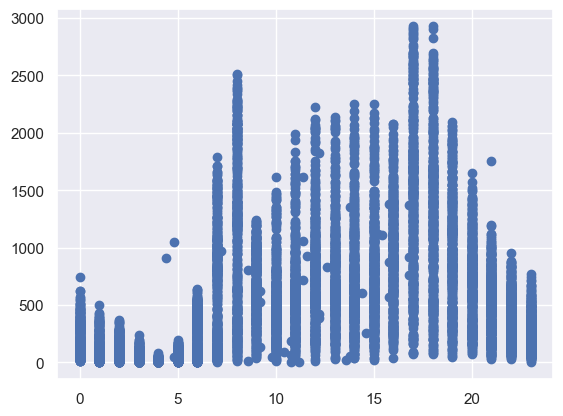

In [97]:
plt.scatter(train["HourofDay"], train["RidesBooked"])

In [98]:
def time_day(Data,hours):
    Data.loc[(Data[hours] > 4) & (Data[hours] <= 10),"time_day"] = 0 #morning
    Data.loc[(Data[hours] > 10) & (Data[hours] <= 16),"time_day"] = 0.33 #afternoon
    Data.loc[(Data[hours] > 16) & (Data[hours] <= 22),"time_day"] = 0.66 #evening
    Data.loc[(Data[hours] > 22) & (Data[hours] <= 4),"time_day"] = 1 #night
    return Data

In [99]:
def Time_line(Data,Year,month):
    Data["Time_line"]= Data[month]+(Data["Year"]-3)*12
    return Data

In [100]:
train = Time_line(train,"Year","Month")
val = Time_line(val,"Year","Month")

In [101]:
test_raw = Time_line(test_raw,"Year","Month")
data_raw = Time_line(data_raw,"Year","Month")

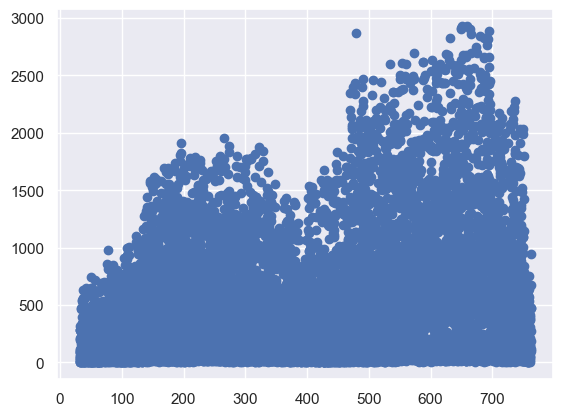

In [102]:
plt.scatter(train["Date"],train["RidesBooked"])

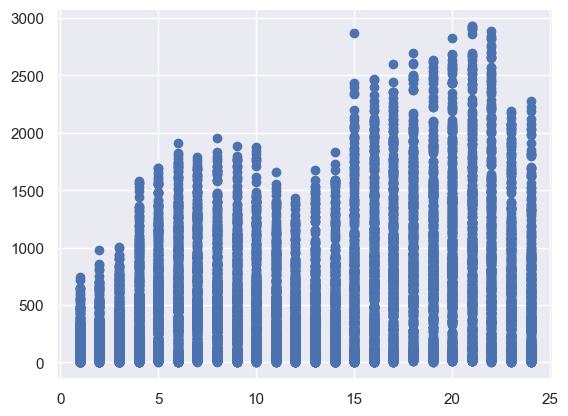

In [103]:
plt.scatter(train["Time_line"],train["RidesBooked"])

In [104]:
train = time_day(train,"HourofDay")
val = time_day(val,"HourofDay")

In [105]:
test_raw = time_day(test_raw,"HourofDay")
data_raw = time_day(data_raw,"HourofDay")

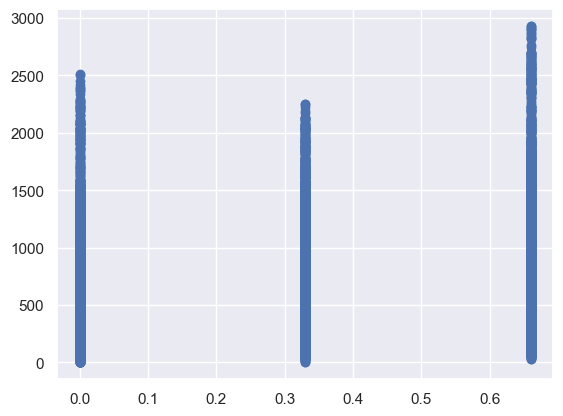

In [106]:
plt.scatter(train["time_day"],train["RidesBooked"])

In [107]:
numerical_features.append("time_day")

### 3.4. Feature Selection

Deleting feature that we cannot use such as FeltTemperature or constant such as City_Detroit

In [108]:
del train["FeltTemperature"] 
del test_raw["FeltTemperature"]
del val["FeltTemperature"]
del data_raw["FeltTemperature"]
del train["City_Detroit"]
del test_raw["City_Detroit"]
del val["City_Detroit"]
del data_raw["City_Detroit"]

In [109]:
train.var()

InstanceID                            6.850037e+08
Year                                  2.500228e-01
Month                                 1.175249e+01
HourofDay                             4.786171e+01
Holiday                               2.737163e-02
DayofWeek                             4.010431e+00
WorkingDay                            2.170936e-01
Temperature                           5.969396e+01
Humidity                              3.636402e-02
WindSpeed                             1.264263e-02
DayofMonth                            7.735566e+01
AverageRideDurationPreviousDay_Min    7.505607e+01
WeekofYear                            2.235621e+02
RidesBooked                           2.963692e+05
Date                                  4.398159e+04
Season_ord                            1.215299e+00
WeatherForecast_ord                   4.070809e-01
Season_0                              1.802397e-01
Season_1                              1.890886e-01
Season_2                       

Creating list of the variable of the coloum for the next step

In [110]:
Tot = ['Year',
       'Month',
       'HourofDay',
       'Holiday',
       'DayofWeek',
       'WorkingDay',
       'Temperature',
       'Humidity',
       'WindSpeed',
       'DayofMonth',
       'AverageRideDurationPreviousDay_Min',
       'Date',
       'Season_ord',
       'WeatherForecast_ord',
       'Season_0',
       'Season_1',
       'Season_2',
       'Season_3',
       'WeatherForecast_0.0',
       'WeatherForecast_1.0',
       'WeatherForecast_2.0',
       'WeatherForecast_3.0',
       'Time_line']

In [111]:
p1 = [
'Year',
'Month',
'DayofMonth',
'HourofDay',
'DayofWeek',
'Holiday',
'WorkingDay',
'Temperature',
'Humidity',
'WindSpeed',
'AverageRideDurationPreviousDay_Min',
'WeekofYear',
'RidesBooked',
]

p2 = [
'RidesBooked',
'Date',
'Time_line',
'time_day',
'Season_ord',
'Season_0',
'Season_1',
'Season_2',
'Season_3',
'WeatherForecast_0.0',
'WeatherForecast_1.0',
'WeatherForecast_2.0',
'WeatherForecast_ord'
]

## Ex-ante Feature selection

In [112]:
cor_spearman2 = train[p1].corr(method = 'spearman')
cor_spearman2

,Year,Month,DayofMonth,HourofDay,DayofWeek,Holiday,WorkingDay,Temperature,Humidity,WindSpeed,AverageRideDurationPreviousDay_Min,WeekofYear,RidesBooked
Year,1.000000,-0.012670,-0.001231,-0.004900,0.010362,0.000110,-0.007211,0.032036,-0.090689,-0.006343,-0.001436,-0.009402,0.203141
Month,-0.012670,1.000000,-0.008547,0.002212,0.007282,0.012019,-0.001569,0.180087,0.151374,-0.126941,0.011081,0.969003,0.123908
DayofMonth,-0.001231,-0.008547,1.000000,0.003026,-0.009711,-0.014985,0.014738,0.016609,0.020497,0.029427,-0.003095,0.049365,-0.014782
HourofDay,-0.004900,0.002212,0.003026,1.000000,-0.004218,-0.014860,0.014079,0.129962,-0.272708,0.141390,-0.007947,0.002260,0.515323
DayofWeek,0.010362,0.007282,-0.009711,-0.004218,1.000000,-0.190830,-0.706221,-0.034984,-0.036772,0.010766,0.011840,0.009733,0.007370
Holiday,0.000110,0.012019,-0.014985,-0.014860,-0.190830,1.000000,-0.248985,-0.020116,-0.007615,-0.002340,0.011562,0.012115,-0.040222
WorkingDay,-0.007211,-0.001569,0.014738,0.014079,-0.706221,-0.248985,1.000000,0.055574,0.013677,-0.016047,-0.022089,-0.009329,0.032668
Temperature,0.032036,0.180087,0.016609,0.129962,-0.034984,-0.020116,0.055574,1.000000,-0.072407,0.016548,-0.005965,0.175653,0.418694
Humidity,-0.090689,0.151374,0.020497,-0.272708,-0.036772,-0.007615,0.013677,-0.072407,1.000000,-0.281646,-0.009545,0.159745,-0.369711
WindSpeed,-0.006343,-0.126941,0.029427,0.141390,0.010766,-0.002340,-0.016047,0.016548,-0.281646,1.000000,0.003108,-0.119236,0.137676


In [113]:
cor_spearman1 = train[p2].corr(method = 'spearman')
cor_spearman1

,RidesBooked,Date,Time_line,time_day,Season_ord,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_ord
RidesBooked,1.000000,0.238268,0.239062,0.276868,0.180159,-0.249478,0.056309,0.154555,0.030833,0.106833,-0.030441,-0.136684,-0.123214
Date,0.238268,1.000000,0.999115,0.010998,0.408968,-0.273482,-0.167073,0.098797,0.336680,0.016907,-0.005215,-0.020990,-0.019374
Time_line,0.239062,0.999115,1.000000,0.011299,0.409634,-0.274039,-0.166999,0.098591,0.337365,0.016661,-0.004770,-0.021278,-0.019208
time_day,0.276868,0.010998,0.011299,1.000000,0.012487,-0.005869,-0.003387,-0.007459,0.016926,0.062558,-0.077643,0.016593,-0.053243
Season_ord,0.180159,0.408968,0.409634,0.012487,1.000000,-0.759540,-0.286617,0.259333,0.771591,0.021835,-0.015840,-0.012445,-0.022165
Season_0,-0.249478,-0.273482,-0.274039,-0.005869,-0.759540,1.000000,-0.323448,-0.332730,-0.318171,-0.045122,0.040546,0.013136,0.043354
Season_1,0.056309,-0.167073,-0.166999,-0.003387,-0.286617,-0.323448,1.000000,-0.348701,-0.333443,-0.011356,0.000731,0.018564,0.013884
Season_2,0.154555,0.098797,0.098591,-0.007459,0.259333,-0.332730,-0.348701,1.000000,-0.343012,0.097383,-0.078082,-0.043526,-0.096522
Season_3,0.030833,0.336680,0.337365,0.016926,0.771591,-0.318171,-0.333443,-0.343012,1.000000,-0.043669,0.039160,0.012841,0.041983
WeatherForecast_0.0,0.106833,0.016907,0.016661,0.062558,0.021835,-0.045122,-0.011356,0.097383,-0.043669,1.000000,-0.824322,-0.410702,-0.984099


In [114]:
def cor_heatmap(cor):
    plt.figure(figsize=(12,10))
    sns.heatmap(data = cor, annot = True, cmap = plt.cm.Reds, fmt='.1')
    plt.show()

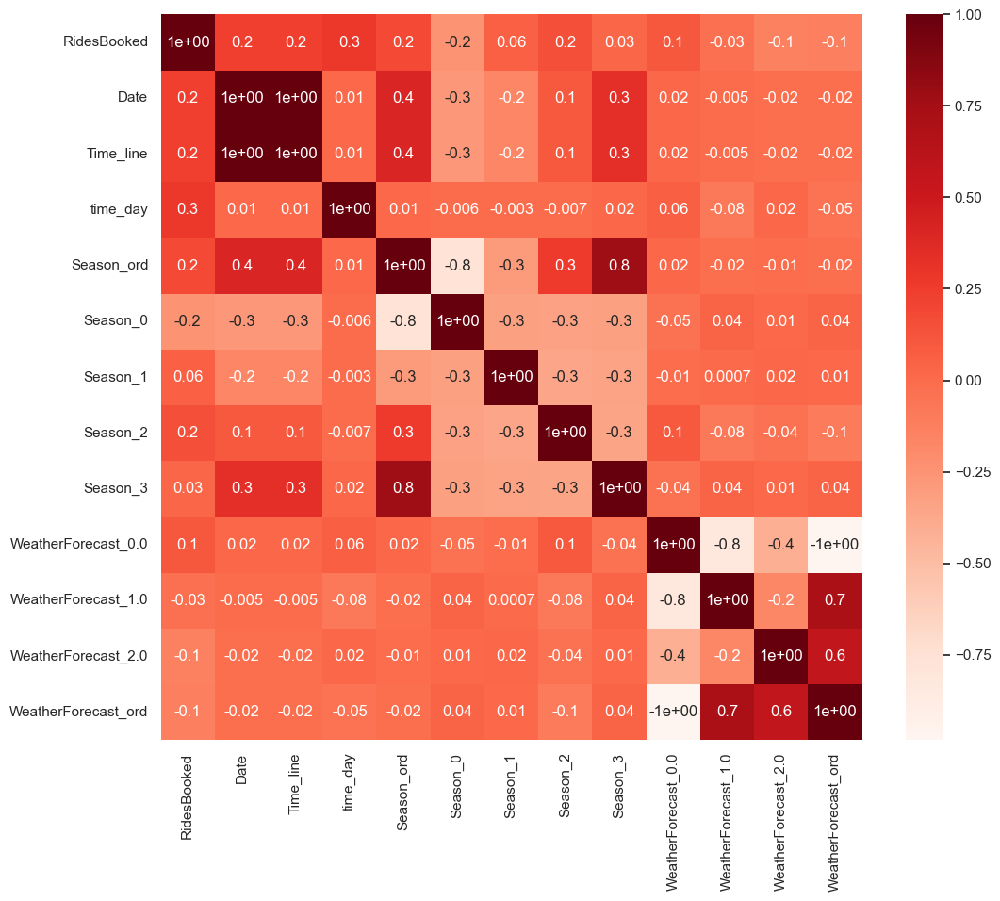

In [115]:
cor_heatmap(cor_spearman1)

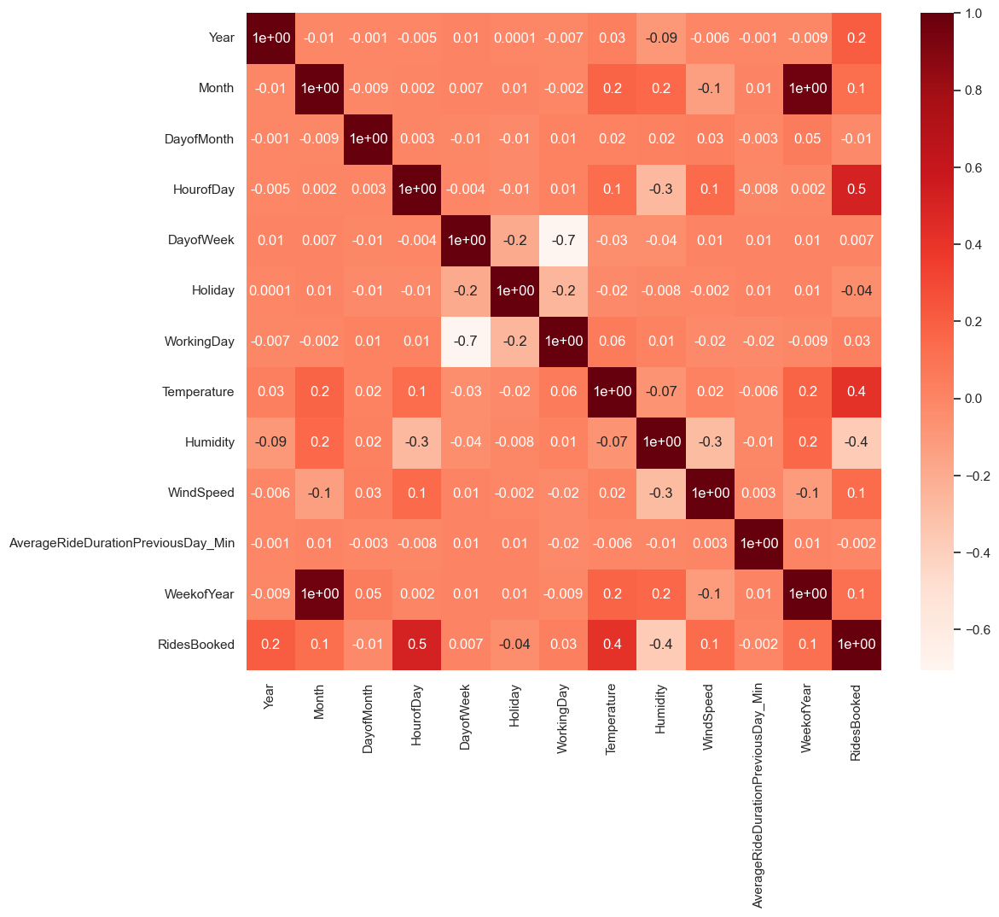

In [116]:
cor_heatmap(cor_spearman2)

### Feature selected using speramann correlation

In [117]:
Feature_selected = ["HourofDay","Temperature","Humidity","WindSpeed","Date","WeatherForecast_ord","Season_0","Season_2"]

In [118]:
Val_selected = val[Feature_selected].copy()

In [119]:
Test = test_raw[Feature_selected].copy()

In [120]:
Train_selected = train[Feature_selected].copy()

In [121]:
data_raw

,InstanceID,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,...,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line,time_day
0,78224,4.0,5.0,8.0,0.0,3.0,1.0,17.170,0.83,0.1343,...,0,1,0,0,0,1,0,0,17.0,0.00
1,53017,3.0,4.0,3.0,0.0,6.0,0.0,9.979,0.54,0.1940,...,0,1,0,0,0,1,0,0,4.0,NaN
2,88477,3.0,10.0,17.0,0.0,2.0,1.0,17.170,0.78,0.2537,...,0,0,0,1,0,1,0,0,10.0,0.66
3,21418,3.0,9.0,13.0,0.0,4.0,1.0,19.567,0.83,0.1940,...,0,0,1,0,0,1,0,0,9.0,0.33
4,24928,4.0,6.0,9.0,0.0,2.0,1.0,16.371,0.46,0.4179,...,0,0,1,0,1,0,0,0,18.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12681,45899,3.0,4.0,3.0,0.0,1.0,1.0,8.381,0.66,0.2836,...,0,1,0,0,1,0,0,0,4.0,NaN
12682,49210,4.0,2.0,20.0,0.0,4.0,1.0,5.984,0.36,0.0000,...,1,0,0,0,1,0,0,0,14.0,0.66
12683,31905,4.0,5.0,9.0,0.0,4.0,1.0,12.376,0.88,0.1045,...,0,1,0,0,0,1,0,0,17.0,0.00
12684,44406,4.0,1.0,23.0,0.0,4.0,1.0,9.180,0.82,0.0000,...,1,0,0,0,0,1,0,0,13.0,NaN


In [122]:
test_raw

,InstanceID,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,...,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line,time_day
0,72270,4.0,6.0,3.0,0.0,7.0,0.0,14.773,0.64,0.1045,...,0,1,0,0,1,0,0,0,18.0,NaN
1,79321,3.0,11.0,0.0,0.0,7.0,0.0,9.180,0.58,0.1940,...,0,0,0,1,0,1,0,0,11.0,NaN
2,66738,3.0,3.0,0.0,0.0,1.0,1.0,1.190,1.00,0.3284,...,1,0,0,0,0,0,1,0,3.0,NaN
3,42387,3.0,6.0,4.0,0.0,6.0,0.0,20.366,0.79,0.0896,...,0,1,0,0,1,0,0,0,6.0,NaN
4,86803,3.0,6.0,5.0,0.0,2.0,1.0,16.371,0.88,0.1642,...,0,1,0,0,1,0,0,0,6.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4688,33525,3.0,5.0,15.0,0.0,2.0,1.0,29.155,0.37,0.1642,...,0,1,0,0,1,0,0,0,5.0,0.33
4689,80263,4.0,8.0,6.0,0.0,6.0,0.0,18.768,0.78,0.1642,...,0,0,1,0,0,1,0,0,20.0,0.00
4690,91916,4.0,11.0,6.0,0.0,7.0,0.0,5.185,0.87,0.0896,...,0,0,0,1,1,0,0,0,23.0,0.00
4691,47074,3.0,8.0,13.0,0.0,5.0,1.0,24.361,0.29,0.0896,...,0,0,1,0,1,0,0,0,8.0,0.33


In [123]:
train

,InstanceID,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,...,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line,time_day
10563,24884,3.0,7.0,10.0,0.0,6.0,0.0,25.160,0.36,0.0000,...,0,0,1,0,1,0,0,0,7.0,0.00
1783,57580,3.0,11.0,5.0,0.0,4.0,1.0,5.984,0.81,0.1343,...,0,0,0,1,1,0,0,0,11.0,0.00
10531,43315,4.0,3.0,12.0,0.0,7.0,0.0,6.783,0.42,0.3582,...,1,0,0,0,1,0,0,0,15.0,0.33
11487,10268,3.0,10.0,1.0,0.0,4.0,1.0,12.376,0.63,0.1940,...,0,0,0,1,1,0,0,0,10.0,NaN
4390,59426,3.0,6.0,3.0,0.0,7.0,0.0,18.768,0.89,0.2836,...,0,1,0,0,1,0,0,0,6.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2204,16399,3.0,6.0,4.0,0.0,7.0,0.0,17.170,0.64,0.0896,...,0,0,1,0,1,0,0,0,6.0,NaN
6528,84897,4.0,5.0,12.0,0.0,3.0,1.0,19.567,0.69,0.0896,...,0,1,0,0,0,1,0,0,17.0,0.33
8076,87319,4.0,1.0,21.0,0.0,6.0,0.0,10.778,0.44,0.2239,...,1,0,0,0,1,0,0,0,13.0,0.66
3829,58324,4.0,11.0,14.0,1.0,4.0,0.0,12.376,0.29,0.0000,...,0,0,0,1,1,0,0,0,23.0,0.33


In [124]:
val

,InstanceID,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,...,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line,time_day
13933,85247,4.0,12.0,23.0,0.0,2.0,1.0,12.376,0.67,0.2537,...,0,0,0,1,1,0,0,0,24.0,NaN
12592,31004,3.0,10.0,16.0,1.0,1.0,0.0,21.165,0.45,0.0896,...,0,0,0,1,0,1,0,0,10.0,0.33
1926,20401,4.0,8.0,9.0,0.0,1.0,1.0,18.768,0.69,0.0000,...,0,0,1,0,0,1,0,0,20.0,0.00
2088,68270,4.0,8.0,8.0,0.0,5.0,1.0,21.964,0.70,0.1343,...,0,0,1,0,1,0,0,0,20.0,0.00
4394,16322,4.0,11.0,22.0,1.0,4.0,0.0,5.984,0.61,0.0000,...,0,0,0,1,1,0,0,0,23.0,0.66
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8804,71465,4.0,1.0,2.0,0.0,4.0,1.0,7.582,0.93,0.2537,...,1,0,0,0,0,0,1,0,13.0,NaN
9304,57158,4.0,5.0,21.0,1.0,1.0,0.0,23.562,0.66,0.2836,...,0,1,0,0,1,0,0,0,17.0,0.66
11124,95600,3.0,3.0,20.0,0.0,3.0,1.0,7.582,0.29,0.4179,...,1,0,0,0,1,0,0,0,3.0,0.66
6231,26628,3.0,11.0,21.0,1.0,4.0,0.0,7.582,0.71,0.1642,...,0,0,0,1,1,0,0,0,11.0,0.66


In [125]:
y_train = train["RidesBooked"]
x_train = Train_selected[Feature_selected]
y_val = val["RidesBooked"]
x_val = Val_selected[Feature_selected]

x_data_raw = data_raw.drop('RidesBooked',axis=1)
y_data_raw  = data_raw["RidesBooked"]
x_test = test_raw

### 3.3. Scaling

In [126]:
minmax_scaler = MinMaxScaler()

#scaling
feature_scaler = MinMaxScaler().fit(x_train)
target_scaler = MinMaxScaler().fit(pd.DataFrame(y_train))

#scale x_train and x_val using feature_scaler
x_train_scaled = pd.DataFrame(feature_scaler.transform(x_train), columns=x_train.columns, index=x_train.index)
x_val_scaled = pd.DataFrame(feature_scaler.transform(x_val), columns= x_val.columns, index=x_val.index)

#scale y_train and y_val using targety_scaler
y_train_scaled = pd.DataFrame(target_scaler.transform(pd.DataFrame(y_train)), columns=[y_train.name], index=y_train.index)
y_val_scaled = pd.DataFrame(target_scaler.transform(pd.DataFrame(y_val)), columns=[y_val.name], index=y_val.index)

#scaling
feature_scaler = MinMaxScaler().fit(x_data_raw)
target_scaler = MinMaxScaler().fit(pd.DataFrame(y_data_raw))

#scale x_data_raw and x_test using feature_scaler
x_data_raw_scaled = pd.DataFrame(feature_scaler.transform(x_data_raw), columns=x_data_raw.columns, index=x_data_raw.index)
x_test_scaled = pd.DataFrame(feature_scaler.transform(x_test), columns= x_test.columns, index=x_test.index)

#scale y_data_raw and y_test using targety_scaler
y_data_raw_scaled = pd.DataFrame(target_scaler.transform(pd.DataFrame(y_data_raw)), columns=[y_data_raw.name], index=y_data_raw.index)

<a class="anchor" id="">

# 4 & 5. Model & Assess (Modelling and Assessment)

</a>

In [127]:
# 5 neighbors KNN
train_acc = []
train_f1 = []
val_acc = []
val_f1 = []

knn = KNeighborsClassifier().fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val)
    
#Assess performance and store results in a list
train_acc.append(knn.score(x_train_scaled, y_train))
val_acc.append(knn.score(x_val_scaled, y_val))
train_f1.append(f1_score(y_train, train_pred,average='micro'))
val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 501.47617341454674


In [128]:
# 1 neighbors
nn1_train_acc = []
nn1_train_f1 = []
nn1_val_acc = []
nn1_val_f1 = []

knn = KNeighborsClassifier(n_neighbors = 1).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val)
    
#Assess performance and store results in a list
nn1_train_acc.append(knn.score(x_train_scaled, y_train))
nn1_val_acc.append(knn.score(x_val_scaled, y_val))
nn1_train_f1.append(f1_score(y_train, train_pred,average = None))
nn1_val_f1.append(f1_score(y_val, val_pred,average = None))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 500.3120745252598


In [129]:
# 10 neighbors
nn10_train_acc = []
nn10_train_f1 = []
nn10_val_acc = []
nn10_val_f1 = []

knn = KNeighborsClassifier(n_neighbors = 10).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
nn10_train_acc.append(knn.score(x_train_scaled, y_train))
nn10_val_acc.append(knn.score(x_val_scaled, y_val))
nn10_train_f1.append(f1_score(y_train, train_pred,average = None))
nn10_val_f1.append(f1_score(y_val, val_pred,average = None))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 332.0068075958438


In [130]:
# 20 neighbors
nn20_train_acc = []
nn20_train_f1 = []
nn20_val_acc = []
nn20_val_f1 = []

knn = KNeighborsClassifier(n_neighbors = 20).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
nn20_train_acc.append(knn.score(x_train_scaled, y_train))
nn20_val_acc.append(knn.score(x_val, y_val))
nn20_train_f1.append(f1_score(y_train, train_pred,average='micro'))
nn20_val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 344.923683267646


In [131]:
# 30 neighbors
nn30_train_acc = []
nn30_train_f1 = []
nn30_val_acc = []
nn30_val_f1 = []

knn = KNeighborsClassifier(n_neighbors = 30).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
nn30_train_acc.append(knn.score(x_train_scaled, y_train))
nn30_val_acc.append(knn.score(x_val_scaled, y_val))
nn30_train_f1.append(f1_score(y_train, train_pred,average='micro'))
nn30_val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 329.4711572912934


In [132]:
# kd_tree
kd_tree_train_acc = []
kd_tree_train_f1 = []
kd_tree_val_acc = []
kd_tree_val_f1 = []

knn = KNeighborsClassifier(algorithm = 'kd_tree').fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
kd_tree_train_acc.append(knn.score(x_train_scaled, y_train))
kd_tree_val_acc.append(knn.score(x_val_scaled, y_val))
kd_tree_train_f1.append(f1_score(y_train, train_pred,average='micro'))
kd_tree_val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 286.9831601576496


In [133]:
# minkowski metric with p = 1
manhattan_train_acc = []
manhattan_train_f1 = []
manhattan_val_acc = []
manhattan_val_f1 = []

knn = KNeighborsClassifier(metric = 'minkowski', p = 1).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
manhattan_train_acc.append(knn.score(x_train_scaled, y_train))
manhattan_val_acc.append(knn.score(x_val_scaled, y_val))
manhattan_train_f1.append(f1_score(y_train, train_pred,average='micro'))
manhattan_val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 288.04407022572553
Results on rescaled outcome variable:
MAE: 288.04407022572553


In [134]:
# minkowski metric with p = 5
minkowski_5_train_acc = []
minkowski_5_train_f1 = []
minkowski_5_val_acc = []
minkowski_5_val_f1 = []

knn = KNeighborsClassifier(metric = 'minkowski', p = 5).fit(x_train_scaled, y_train)
    
#Make predictions
train_pred = knn.predict(x_train_scaled)
val_pred = knn.predict(x_val_scaled)
    
#Assess performance and store results in a list
minkowski_5_train_acc.append(knn.score(x_train_scaled, y_train))
minkowski_5_val_acc.append(knn.score(x_val_scaled, y_val))
minkowski_5_train_f1.append(f1_score(y_train, train_pred,average='micro'))
minkowski_5_val_f1.append(f1_score(y_val, val_pred,average='micro'))
    
#Print MSE
print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, val_pred)}')

Results on rescaled outcome variable:
MAE: 288.64493013256896


In [135]:
#Linear Regression
y_train = train["RidesBooked"]
x_train = Train_selected[Feature_selected]

lr_default = LinearRegression()

lr_default.fit(X = x_train_scaled, y = y_train_scaled)

y_pred_default_scaled = lr_default.predict(x_val_scaled)

#measures of predictions scaled
print(f'MAE: {mean_absolute_error(y_val_scaled, y_pred_default_scaled)}\n' +
      f'R_Squared: {r2_score(y_val_scaled, y_pred_default_scaled)}')

#measures of predictions rescaled
y_pred_default_rescaled = target_scaler.inverse_transform(y_pred_default_scaled)

print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, y_pred_default_rescaled)}\n' +
      f'R_Squared: {r2_score(y_val, y_pred_default_rescaled)}')

MAE: 0.10831995238607425
R_Squared: 0.4000890414381023
Results on rescaled outcome variable:
MAE: 317.16082058642536
R_Squared: 0.4000890414381024


In [136]:
#Linear Regression with hyper parameter intercept
lr_noicept = LinearRegression(fit_intercept = False)

lr_noicept.fit(x_train_scaled, y_train)

pred_noicept = lr_noicept.predict(x_val_scaled)

print(f'Results on rescaled outcome variable:\n' +
      f'MAE: {mean_absolute_error(y_val, pred_noicept)}\n' +
      f'R_Squared: {r2_score(y_val,pred_noicept)}')

Results on rescaled outcome variable:
MAE: 317.22134936367326
R_Squared: 0.39988726472480374


In [137]:
mlpr = MLPRegressor()

In [138]:
param_list = {"hidden_layer_sizes": [(1,),(10,),(50,)], "activation": ["identity", "tanh", "relu"], "solver": ["sgd", "adam"], "alpha": [0.00005,0.0005,0.0001]}

In [139]:
clf = GridSearchCV(estimator=mlpr, param_grid=param_list, scoring = 'neg_mean_absolute_error')

In [140]:
clf.fit(x_data_raw_scaled[Tot],y_data_raw)

GridSearchCV(estimator=MLPRegressor(),
             param_grid={'activation': ['identity', 'tanh', 'relu'],
                         'alpha': [5e-05, 0.0005, 0.0001],
                         'hidden_layer_sizes': [(1,), (10,), (50,)],
                         'solver': ['sgd', 'adam']},
             scoring='neg_mean_absolute_error')

In [141]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', clf.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std , params))
    
# Best results
print("BEST RESULTS: %0.5f (+/-%0.05f) for %r" % (clf.best_score_, \
                                    clf.cv_results_['std_test_score'][clf.best_index_], clf.best_params_))

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (50,), 'solver': 'adam'}
------------------------------------------------------------------------------------------------------------------------
nan (+/-nan) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (1,), 'solver': 'sgd'}
-391.557 (+/-2.549) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (1,), 'solver': 'adam'}
nan (+/-nan) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (10,), 'solver': 'sgd'}
-334.508 (+/-2.336) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (10,), 'solver': 'adam'}
nan (+/-nan) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (50,), 'solver': 'sgd'}
-317.724 (+/-2.484) for {'activation': 'identity', 'alpha': 5e-05, 'hidden_layer_sizes': (50,), 'solver

# K fold implementation

In [142]:
def avg_score(Feature_selected,model):
    
    # apply kfold
    kf = KFold(n_splits=10)
    
    # create lists to store the results from the different models 
    mae_score_train = []
    mae_score_test = []
    timer = []
    
    for train_index, test_index in kf.split(X):
        
        # get the indexes of the observations assigned for each partition
        train, val = X.iloc[train_index], X.iloc[test_index]
        
        train = remove_outlier(train,'WindSpeed')
        train = error_outlier(train,'Humidity')
        
        #Missing value
              
        #month
        prova = train[["DayofWeek","DayofMonth","Month","Year"]].copy()
    
        imputer = KNNImputer(n_neighbors=1)

        imputer.fit(prova)
        data_new = imputer.transform(prova)
        df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = train.index)

        train["Month"] = df_imputed["Month"]

        prova = val[["DayofWeek","DayofMonth","Month","Year"]].copy()
        val_new = imputer.transform(prova)
        df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = val.index)


        val["Month"] = df_val_imputed["Month"]
        val.loc[val["Year"]== 0,"DayofWeek"] =np.nan
        #year
        prova = train[["DayofWeek","DayofMonth","Month","Year"]].copy()
        imputer = KNNImputer(n_neighbors=1)

        imputer.fit(prova)
        data_new = imputer.transform(prova)
        df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = train.index)


        train["Year"] = df_imputed["Year"]

        prova = val[["DayofWeek","DayofMonth","Month","Year"]].copy()
        val_new = imputer.transform(prova)
        df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","Month","Year"], index = val.index)


        val["Year"] = df_val_imputed["Year"]
        
        
        #creating a time line
        def Date(Data,day,month,year):
            month1 = [31,28,31,30,31,30,31,31,30,31,30,31]
            month2 = [31,29,31,30,31,30,31,31,30,31,30,31]
            y1=[31]
            y2=[31]
            for i in range(1, len(month1)):
                y1.append(month1[i]+y1[i-1])

            y1
            for i in range(1, len(month2)):
                y2.append(month2[i]+y2[i-1])

            y2

            y_1 = { i+1 : y1[i] for i in range(len(y1)) }
            y_2 = { i+1 : y2[i] for i in range(len(y2)) }
            Data['Help'] = Data[month].map(y_1)
            Data['Help2'] = Data[month].map(y_2)
            Data['Help'] = Data['Help'] + Data[day]
            Data['Help2'] = Data['Help2'] + Data[day]
            Data['Difference year'] = Data[year]-3
            Data.loc[Data['Difference year']==0, 'Date'] = Data['Help']
            Data.loc[Data['Difference year']==1, 'Date'] = Data['Help2']+365
            del Data['Help2']
            del Data['Help']
            del Data['Difference year']


            return Data
        train = Date(train,'DayofMonth','Month','Year')

        val = Date(val,'DayofMonth','Month','Year')
        
        
        
        ### Missing values for "HourofDay"


        s_t=pd.get_dummies(train[["Season","Temperature","HourofDay"]])
        s_t_v=pd.get_dummies(val[["Season","Temperature","HourofDay"]])
        s_t_t=pd.get_dummies(test[["Season","Temperature","HourofDay"]])

        imputer = KNNImputer()
        imputer.fit(s_t)
        new_s_t = imputer.transform(s_t)
        new_s_t_v = imputer.transform(s_t_v)

        train["HourofDay"]=pd.DataFrame(new_s_t,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values
        val["HourofDay"]=pd.DataFrame(new_s_t_v,columns=["Temperature","HourofDay","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).drop(columns=["Temperature","Season_Fall","Season_Spring","Season_Summer","Season_Winter"]).values



        #Fill missing value Temperature
        train["Help"]=train["Temperature"]-train["FeltTemperature"]
        grouped=train.groupby('Date')['Help'].mean().to_dict()
        grouped[np.nan]=np.nan
        train["Help2"] = train['Date'].map(grouped)
        train.loc[train['Temperature'].isna(), 'Temperature'] = train["FeltTemperature"] + train["Help2"]
        del train["Help2"]
        del train["Help"]

        val["Help"]=val['Temperature']-val["FeltTemperature"]
        val["Help2"] = val['Date'].map(grouped)
        val.loc[val['Temperature'].isna(), 'Temperature'] = val["FeltTemperature"] + val["Help2"]
        del val["Help2"]
        del val["Help"]

        #if there is a problem in the map I have to fill in someway the missing value
        mean_value=train['Temperature'].median()
        val['Temperature'].fillna(value=mean_value, inplace=True)




        #Fill missing value FeltTemperature
        train["Help"]=train['Temperature']-train["FeltTemperature"]
        grouped=train.groupby('Date')['Help'].mean().to_dict()
        grouped[np.nan]=np.nan
        train["Help2"] = train['Date'].map(grouped)
        train.loc[train["FeltTemperature"].isna(), "FeltTemperature"] = train['Temperature'] - train["Help2"]
        del train["Help2"]
        del train["Help"]

        val["Help"]=val['Temperature']-val["FeltTemperature"]
        val["Help2"] = val['Date'].map(grouped)
        val.loc[val["FeltTemperature"].isna(), "FeltTemperature"] = val['Temperature'] - val["Help2"]
        del val["Help2"]
        del val["Help"]

        #if there is a problem in the map I have to fill in someway the missing value
        mean_value=train['FeltTemperature'].median()
        val['FeltTemperature'].fillna(value=mean_value, inplace=True)


        # missing values for WindSpeed
        grouped =train.groupby('Date')['WindSpeed'].median().to_dict()
        grouped[np.nan]=np.nan
        train['WindSpeed'] = train['WindSpeed'].fillna(train['Date'].map(grouped))
        val['WindSpeed'] = val['WindSpeed'].fillna(val['Date'].map(grouped))

        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['WindSpeed'].median()
        val['WindSpeed'].fillna(value=mean_value, inplace=True)


        #AverageRideDurationPreviousDay_Min mean of each day
        grouped =train.groupby('Date')['AverageRideDurationPreviousDay_Min'].median().to_dict()
        grouped[np.nan]=np.nan
        train['AverageRideDurationPreviousDay_Min'] = train['AverageRideDurationPreviousDay_Min'].fillna(train['Date'].map(grouped))
        val['AverageRideDurationPreviousDay_Min'] = val['AverageRideDurationPreviousDay_Min'].fillna(val['Date'].map(grouped))

        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['AverageRideDurationPreviousDay_Min'].median()
        val['AverageRideDurationPreviousDay_Min'].fillna(value=mean_value, inplace=True)

        mean_value=train['AverageRideDurationPreviousDay_Min'].median()
        train['AverageRideDurationPreviousDay_Min'].fillna(value=mean_value, inplace=True)
        
        
        #fill Humidity
        grouped=train.groupby('Date')['Humidity'].median().to_dict()
        grouped[np.nan]=np.nan
        train['Humidity'] = train['Humidity'].fillna(train['Date'].map(grouped))
        val['Humidity'] = val['Humidity'].fillna(val['Date'].map(grouped))

        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['Humidity'].median()
        train['Humidity'].fillna(value=mean_value, inplace=True)
        
        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['Humidity'].median()
        val['Humidity'].fillna(value=mean_value, inplace=True)


        #fill Nan weater forecast and transform in numerical
        dictionary ={
            np.nan :  np.nan,
            "Mist" : 1,
            "Clear" : 0,
            "LightRain" :2,
            "HeavyRain" :3,
            }
        train['WeatherForecast_new'] = train['WeatherForecast'].map(dictionary)
        train['WeatherForecast'] = train['WeatherForecast_new']
        del train['WeatherForecast_new']
        grouped_weatherforecast_date =train.groupby('Date')['WeatherForecast'].median().to_dict()
        train['WeatherForecast'] = train['WeatherForecast'].fillna(train['Date'].map(grouped_weatherforecast_date))
        train['WeatherForecast'] = train['WeatherForecast'].round()

        val['WeatherForecast_new'] = val['WeatherForecast'].map(dictionary)
        val['WeatherForecast'] = val['WeatherForecast_new']
        del val['WeatherForecast_new']
        val['WeatherForecast'] = val['WeatherForecast'].fillna(val['Date'].map(grouped_weatherforecast_date))
        
        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['WeatherForecast'].median()
        train['WeatherForecast'].fillna(value=mean_value, inplace=True)
        train['WeatherForecast'] = train['WeatherForecast'].round()
        
        
        #if there is a problem in the map function I have to fill in someway the missing value
        mean_value=train['WeatherForecast'].median()
        val['WeatherForecast'].fillna(value=mean_value, inplace=True)
        val['WeatherForecast'] = val['WeatherForecast'].round()


        #KNN imputer for solve DayofWeek,Holiday,WorkingDay
        prova = train[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy()



        imputer = KNNImputer()
        imputer.fit(prova)
        data_new = imputer.transform(prova)
        df_imputed = pd.DataFrame(data_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = train.index)


        train["DayofWeek"] = df_imputed["DayofWeek"]
        train["Holiday"] = df_imputed["Holiday"]
        train["WorkingDay"] = df_imputed["WorkingDay"]

        prova = val[["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"]].copy()
        val_new = imputer.transform(prova)
        df_val_imputed = pd.DataFrame(val_new, columns=["DayofWeek","DayofMonth","WorkingDay","Holiday","Month","Year"], index = val.index)


        val["DayofWeek"] = df_val_imputed["DayofWeek"]
        val["Holiday"] = df_val_imputed["Holiday"]
        val["WorkingDay"] = df_val_imputed["WorkingDay"]


        Season ={
            "Winter" : 0,
            "Spring" : 1,
            "Summer": 2,
            "Fall" : 3
        }

        train['Season1'] = train['Season'].map(Season)
        train['Season'] = train['Season1'] 
        del train['Season1'] 

        val['Season1'] = val['Season'].map(Season)
        val['Season'] = val['Season1'] 
        del val['Season1'] 


        train['Season_ord'] = train['Season']
        train['WeatherForecast_ord'] = train['WeatherForecast']

        val['Season_ord'] = val['Season']
        val['WeatherForecast_ord'] = val['WeatherForecast']


        train = pd.get_dummies(train, columns = ['Season'])
        val = pd.get_dummies(val, columns = ['Season'])



        train = pd.get_dummies(train, columns = ['WeatherForecast'])
        train['WeatherForecast_3.0'] = train.get('WeatherForecast_3.0', 0)    

        val = pd.get_dummies(val, columns = ['WeatherForecast'])
        val['WeatherForecast_3.0'] = val.get('WeatherForecast_3.0', 0)    



        def Time_line(Data,Year,month):
            Data["Time_line"]= Data[month]+(Data["Year"]-3)*12
            return Data


        train = Time_line(train,"Year","Month")
        val = Time_line(val,"Year","Month")

        Val_selected = val[Feature_selected]
        Train_selected = train[Feature_selected]

        y_train = y.iloc[train_index]
        x_train = Train_selected[Feature_selected].copy()
        y_val = y.iloc[test_index]
        x_val = Val_selected[Feature_selected].copy()
        
        #print(x_train)
        #print(x_train.isna().sum())
        #print(x_val)
        #print(x_val.isna().sum())
        
        
        #print(train.isna().sum())
        #print(val.isna().sum())
        
        
        minmax_scaler = MinMaxScaler()

        #scaling
        feature_scaler = MinMaxScaler().fit(x_train)
        target_scaler = MinMaxScaler().fit(pd.DataFrame(y_train))

        #scale x_train and x_val using feature_scaler
        x_train_scaled = pd.DataFrame(feature_scaler.transform(x_train), columns=x_train.columns, index=x_train.index)
        x_val_scaled = pd.DataFrame(feature_scaler.transform(x_val), columns= x_val.columns, index=x_val.index)

        #scale y_train and y_val using targety_scaler
        #y_train_scaled = pd.DataFrame(target_scaler.transform(pd.DataFrame(y_train)), columns=[y_train.name], index=y_train.index)
        #y_val_scaled = pd.DataFrame(target_scaler.transform(pd.DataFrame(y_val)), columns=[y_val.name], index=y_val.index)

        #print(train.isna().sum())
        #print(val.isna().sum())
        
        
        X_train=x_train_scaled
        X_val = x_val_scaled
        #y_train = y_train_scaled
        #y_val = y_val_scaled
        
        # start counting time
        begin = time.perf_counter()
        
        # fit the model to the data
        model.fit(X_train, y_train)
        
        # finish counting time
        end = time.perf_counter()
        
        # check the mae for the train
        pred_train = model.predict(X_train)
        
        # store it to new variable
        value_train = mean_absolute_error(y_train, pred_train)
                                   
        # check the mae for the test
        pred_test = model.predict(X_val)
        
        # check the mean accuracy for the test
        value_test = mean_absolute_error(y_val, pred_test)
        
        # append the accuracies, the time and the number of iterations in the corresponding list
        mae_score_train.append(value_train)
        mae_score_test.append(value_test)
        timer.append(end-begin)
    
    # calculate the average and the std for each measure (accuracy, time and number of iterations)
    avg_time = round(np.mean(timer),3)
    avg_train = round(np.mean(mae_score_train),3)
    avg_test = round(np.mean(mae_score_test),3)
    std_time = round(np.std(timer),2)
    std_train = round(np.std(mae_score_train),2)
    std_test = round(np.std(mae_score_test),2)
    
    return str(avg_time) + '+/-' + str(std_time), str(avg_train) + '+/-' + str(std_train),\
            str(avg_test) + '+/-' + str(std_test)

In [143]:
def show_results(Feature_selected,df, *args):
    """
    Receive an empty dataframe and the different models and call the function avg_score
    """
    count = 0
    # for each model passed as argument
    for arg in args:
        # obtain the results provided by avg_score
        time, avg_train, avg_test = avg_score(Feature_selected,arg)
        # store the results in the right row
        df.iloc[count] = time, avg_train, avg_test
        count+=1
    return df

In [144]:
X = data_Kfold
y = data_Kfold["RidesBooked"]

#### Definition of all the models

In [145]:
dt_mae = DecisionTreeRegressor(criterion='absolute_error',max_depth=3)
dt_mae_7 = DecisionTreeRegressor(criterion='absolute_error',max_depth=7)
dt_mae_10 = DecisionTreeRegressor(criterion='absolute_error',max_depth=10)
dt_mae_15 = DecisionTreeRegressor(criterion='absolute_error',max_depth=15)
dt_mae_20 = DecisionTreeRegressor(criterion='absolute_error',max_depth=20)
dt_mae_25 = DecisionTreeRegressor(criterion='absolute_error',max_depth=25)

dt_mae_30 = DecisionTreeRegressor(criterion='absolute_error',max_depth=30)
dt_mae_35 = DecisionTreeRegressor(criterion='absolute_error',max_depth=35)
dt_mae_40 = DecisionTreeRegressor(criterion='absolute_error',max_depth=40)
dt_mae_45 = DecisionTreeRegressor(criterion='absolute_error',max_depth=45)

dt_mae_50 = DecisionTreeRegressor(criterion='absolute_error',max_depth=50)
dt_mae_100 = DecisionTreeRegressor(criterion='absolute_error',max_depth=100)

dt_mse2 = DecisionTreeRegressor(criterion='squared_error',max_depth=3)
dt_mse2_7 = DecisionTreeRegressor(criterion='squared_error',max_depth=7)
dt_mse_35 = DecisionTreeRegressor(criterion='squared_error',max_depth=35)

In [146]:
linear= LinearRegression()
linear_noint = LinearRegression(fit_intercept = False)
KNN=KNeighborsClassifier()
KNN_1=KNeighborsClassifier(n_neighbors = 1)
KNN_10=KNeighborsClassifier(n_neighbors = 10)

In [147]:
NNregressor = MLPRegressor(activation= 'relu', alpha= 0.0001, hidden_layer_sizes = (50,), solver = 'adam')


# Decision of the model

In [148]:
Feature_selected = ["HourofDay","Temperature","Humidity","WindSpeed","Time_line","WeatherForecast_ord","Season_0","Season_2"]

In [149]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['TREE_mae_3','TREE_mae_7','dt_mae_10','dt_mae_15','dt_mae_20','dt_mae_25','dt_mae_30','dt_mae_35','dt_mae_40','dt_mae_45','dt_mae_50','dt_mae_100','TREE_mse_3','TREE_mse_7','linear','linear_noint','KNN','KNN_1','KNN_10'])
show_results(Feature_selected,df,dt_mae,dt_mae_7, dt_mae_10,dt_mae_15,dt_mae_20,dt_mae_25,dt_mae_30,dt_mae_35,dt_mae_40,dt_mae_45,dt_mae_50,dt_mae_100,dt_mse2,dt_mse2_7,linear,linear_noint,KNN,KNN_1,KNN_10)

,Time,Train,Validation
TREE_mae_3,2.37+/-0.1,259.327+/-0.46,261.303+/-5.01
TREE_mae_7,2.919+/-0.23,188.958+/-0.56,196.885+/-5.09
dt_mae_10,3.032+/-0.16,151.636+/-0.86,180.523+/-4.78
dt_mae_15,3.102+/-0.22,78.935+/-1.59,192.684+/-6.05
dt_mae_20,3.213+/-0.21,21.458+/-1.71,206.901+/-6.46
dt_mae_25,3.216+/-0.19,3.6+/-0.68,211.498+/-5.86
dt_mae_30,3.104+/-0.09,1.136+/-0.29,212.273+/-5.83
dt_mae_35,3.197+/-0.17,0.983+/-0.14,211.576+/-7.27
dt_mae_40,3.094+/-0.09,0.976+/-0.13,212.045+/-6.85
dt_mae_45,3.072+/-0.06,0.976+/-0.13,213.461+/-7.2


In [150]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['NNregressor'])
show_results(Feature_selected,df,NNregressor)

,Time,Train,Validation
NNregressor,8.065+/-0.47,314.739+/-1.92,315.004+/-5.82


# Heuristic Feature selection

In [151]:
Feature_selected = ["HourofDay","Temperature","Humidity","WindSpeed","Time_line"]

In [152]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['dt_mae_10','dt_mae_15'])
show_results(Feature_selected,df,dt_mae_10,dt_mae_15)

,Time,Train,Validation
dt_mae_10,2.011+/-0.07,153.829+/-0.99,184.145+/-5.46
dt_mae_15,2.113+/-0.05,78.821+/-1.33,199.004+/-4.53


In [153]:
feature_importance_df = pd.DataFrame(data = [dt_mae_10.feature_importances_,
                                            dt_mae_15.feature_importances_], columns = Feature_selected,
                                            index = ['dt_mae_10', 'dt_mae_15'])

feature_importance_df

,HourofDay,Temperature,Humidity,WindSpeed,Time_line
dt_mae_10,0.658336,0.149596,0.046802,0.013395,0.131871
dt_mae_15,0.533369,0.167524,0.098092,0.064745,0.136270


In [154]:
Feature_selected = ["HourofDay","Temperature","Humidity","WindSpeed","Date","WeatherForecast_ord","Season_0","Season_2"]

In [155]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['dt_mae_10','dt_mae_15'])
show_results(Feature_selected,df,dt_mae_10,dt_mae_15)

,Time,Train,Validation
dt_mae_10,2.927+/-0.05,150.496+/-1.21,180.344+/-4.41
dt_mae_15,3.022+/-0.03,77.375+/-1.53,185.873+/-4.47


In [156]:
feature_importance_df = pd.DataFrame(data = [dt_mae_10.feature_importances_,
                                            dt_mae_15.feature_importances_], columns = Feature_selected,
                                            index = ['dt_mae_10', 'dt_mae_15'])

feature_importance_df

,HourofDay,Temperature,Humidity,WindSpeed,Date,WeatherForecast_ord,Season_0,Season_2
dt_mae_10,0.647963,0.128962,0.033135,0.008621,0.159114,0.020825,0.001113,0.000267
dt_mae_15,0.534159,0.140693,0.064234,0.038124,0.190651,0.025387,0.003887,0.002864


In [157]:
Feature_selected = ["HourofDay","Temperature","Humidity","WindSpeed","Date"]

In [158]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['dt_mae_10','dt_mae_15'])
show_results(Feature_selected,df,dt_mae_10,dt_mae_15)

,Time,Train,Validation
dt_mae_10,2.094+/-0.07,151.654+/-1.01,182.745+/-3.88
dt_mae_15,2.18+/-0.1,75.146+/-1.71,186.807+/-4.84


In [159]:
feature_importance_df = pd.DataFrame(data = [dt_mae_10.feature_importances_,
                                            dt_mae_15.feature_importances_], columns = Feature_selected,
                                            index = ['dt_mae_10', 'dt_mae_15'])

feature_importance_df

,HourofDay,Temperature,Humidity,WindSpeed,Date
dt_mae_10,0.651683,0.137193,0.039953,0.012436,0.158735
dt_mae_15,0.524897,0.147222,0.075613,0.045072,0.207197


### Optimization of the model before the feature selection

In [160]:
dt_mse = DecisionTreeRegressor()
parameter_space = {
    'max_depth': [11,12,13,14,15,16,17],
    'criterion': [ 'poisson', 'squared_error', 'absolute_error']
}

clf = GridSearchCV(dt_mse, parameter_space, scoring = 'neg_mean_absolute_error')
clf.fit(x_data_raw_scaled[Tot],y_data_raw)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['poisson', 'squared_error',
                                       'absolute_error'],
                         'max_depth': [11, 12, 13, 14, 15, 16, 17]},
             scoring='neg_mean_absolute_error')

In [161]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', clf.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std , params))
    
# Best results
print("BEST RESULTS: %0.5f (+/-%0.05f) for %r" % (clf.best_score_, \
                                    clf.cv_results_['std_test_score'][clf.best_index_], clf.best_params_))

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'criterion': 'poisson', 'max_depth': 14}
------------------------------------------------------------------------------------------------------------------------
-107.961 (+/-4.078) for {'criterion': 'poisson', 'max_depth': 11}
-104.691 (+/-2.755) for {'criterion': 'poisson', 'max_depth': 12}
-104.369 (+/-2.220) for {'criterion': 'poisson', 'max_depth': 13}
-103.412 (+/-1.750) for {'criterion': 'poisson', 'max_depth': 14}
-103.746 (+/-2.397) for {'criterion': 'poisson', 'max_depth': 15}
-105.174 (+/-1.575) for {'criterion': 'poisson', 'max_depth': 16}
-106.045 (+/-1.693) for {'criterion': 'poisson', 'max_depth': 17}
-109.246 (+/-2.005) for {'criterion': 'squared_error', 'max_depth': 11}
-106.033 (+/-1.171) for {'criterion': 'squared_error', 'max_depth': 12}
-105.252 (+/-1.856) for {'criterion': 'squared_error', 'max_depth': 13}
-104.996 (+/-0

In [162]:
feature_model = DecisionTreeRegressor(criterion='poisson',max_depth=14)

In [163]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['feature_model'])
show_results(Tot,df,feature_model)

,Time,Train,Validation
feature_model,0.115+/-0.01,39.286+/-1.14,102.167+/-3.88


### Feature selection using feature importance

In [164]:
feature_importance_df = pd.DataFrame(data = [feature_model.feature_importances_], columns = Tot,
                                            index = ['feature_model'])

feature_importance_df

,Year,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,DayofMonth,...,WeatherForecast_ord,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line
feature_model,0.000049,0.001828,0.62813,0.001383,0.013346,0.095073,0.045848,0.018201,0.004118,0.006009,...,0.002659,0.002485,0.000081,0.000093,0.000202,0.000907,0.000786,0.011561,2.795117e-07,0.00143


In [165]:
#Dropping coloum with few feature importance
feature_importance_df = feature_importance_df.drop('Year',axis=1)
feature_importance_df

,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,...,WeatherForecast_ord,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_1.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line
feature_model,0.001828,0.62813,0.001383,0.013346,0.095073,0.045848,0.018201,0.004118,0.006009,0.006765,...,0.002659,0.002485,0.000081,0.000093,0.000202,0.000907,0.000786,0.011561,2.795117e-07,0.00143


In [166]:
#Dropping coloum with few feature importance
feature_importance_df = feature_importance_df.drop('WeatherForecast_1.0',axis=1)
feature_importance_df

,Month,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,...,Season_ord,WeatherForecast_ord,Season_0,Season_1,Season_2,Season_3,WeatherForecast_0.0,WeatherForecast_2.0,WeatherForecast_3.0,Time_line
feature_model,0.001828,0.62813,0.001383,0.013346,0.095073,0.045848,0.018201,0.004118,0.006009,0.006765,...,0.001144,0.002659,0.002485,0.000081,0.000093,0.000202,0.000907,0.011561,2.795117e-07,0.00143


In [167]:
#Dropping coloum with few feature importance
feature_importance_df = feature_importance_df.drop(['WeatherForecast_0.0','WeatherForecast_3.0','Month','Season_2', 'Season_1', 'Season_3','Season_ord'],axis=1)
feature_importance_df

,HourofDay,Holiday,DayofWeek,WorkingDay,Temperature,Humidity,WindSpeed,DayofMonth,AverageRideDurationPreviousDay_Min,Date,WeatherForecast_ord,Season_0,WeatherForecast_2.0,Time_line
feature_model,0.62813,0.001383,0.013346,0.095073,0.045848,0.018201,0.004118,0.006009,0.006765,0.157901,0.002659,0.002485,0.011561,0.00143


#### Feature selected

In [168]:
Feature_selected_final = ["HourofDay",'DayofWeek',"Temperature",'WorkingDay',"Humidity","WindSpeed",'DayofMonth',"Date","WeatherForecast_2.0",'WeatherForecast_ord','AverageRideDurationPreviousDay_Min']

In [169]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['feature_model'])
show_results(Feature_selected_final,df,feature_model)

,Time,Train,Validation
feature_model,0.092+/-0.01,39.283+/-1.03,102.532+/-3.43


Comparison with other model

In [170]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['feature_model','linear','KNN','KNN_1','KNN_10'])
show_results(Feature_selected_final,df,feature_model,linear,KNN,KNN_1,KNN_10)

,Time,Train,Validation
feature_model,0.086+/-0.0,39.284+/-1.02,102.908+/-2.96
linear,0.006+/-0.0,319.264+/-0.67,319.559+/-4.9
KNN,0.037+/-0.0,280.865+/-0.88,311.125+/-6.61
KNN_1,0.037+/-0.0,0.0+/-0.0,279.604+/-9.32
KNN_10,0.038+/-0.0,337.761+/-0.97,352.218+/-9.51


## Model Optimization

#### Implementing GridSearch

In [171]:
dt_mse = DecisionTreeRegressor()
parameter_space = {
    'max_depth': [13,14,15,16],
    'criterion': ['squared_error', 'absolute_error','gini','poisson'],
    'splitter': ['random', 'best'],
    'max_features': [4,6,None],
    'max_leaf_nodes': [3,12, None]
}

clf = GridSearchCV(dt_mse, parameter_space, scoring = 'neg_mean_absolute_error')
clf.fit(x_data_raw_scaled[Feature_selected_final],y_data_raw)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['squared_error', 'absolute_error',
                                       'gini', 'poisson'],
                         'max_depth': [13, 14, 15, 16],
                         'max_features': [4, 6, None],
                         'max_leaf_nodes': [3, 12, None],
                         'splitter': ['random', 'best']},
             scoring='neg_mean_absolute_error')

In [172]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', clf.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std , params))
    
# Best results
print("BEST RESULTS: %0.5f (+/-%0.05f) for %r" % (clf.best_score_, \
                                    clf.cv_results_['std_test_score'][clf.best_index_], clf.best_params_))

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'criterion': 'poisson', 'max_depth': 15, 'max_features': None, 'max_leaf_nodes': None, 'splitter': 'best'}
------------------------------------------------------------------------------------------------------------------------
-402.919 (+/-16.713) for {'criterion': 'squared_error', 'max_depth': 13, 'max_features': 4, 'max_leaf_nodes': 3, 'splitter': 'random'}
-339.731 (+/-29.679) for {'criterion': 'squared_error', 'max_depth': 13, 'max_features': 4, 'max_leaf_nodes': 3, 'splitter': 'best'}
-344.007 (+/-4.438) for {'criterion': 'squared_error', 'max_depth': 13, 'max_features': 4, 'max_leaf_nodes': 12, 'splitter': 'random'}
-275.312 (+/-45.241) for {'criterion': 'squared_error', 'max_depth': 13, 'max_features': 4, 'max_leaf_nodes': 12, 'splitter': 'best'}
-228.158 (+/-5.867) for {'criterion': 'squared_error', 'max_depth': 13, 'max_features': 4

### Final model

In [183]:
Final_model = DecisionTreeRegressor(criterion='poisson',max_depth=15, splitter = 'best')

# Idea for using Felt Temperature

Tot.append('FeltTemperature')

dt_mse = DecisionTreeRegressor()
parameter_space = {
    'max_depth': [11,12,13,14,15,16,17],
    'criterion': [ 'poisson', 'squared_error', 'absolute_error']
}

clf = GridSearchCV(dt_mse, parameter_space, scoring = 'neg_mean_absolute_error')
clf.fit(x_data_raw_scaled[Tot],y_data_raw)

# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', clf.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (mean, std , params))
    
# Best results
print("BEST RESULTS: %0.5f (+/-%0.05f) for %r" % (clf.best_score_, \
                                    clf.cv_results_['std_test_score'][clf.best_index_], clf.best_params_))

Final_model_kaggle = DecisionTreeRegressor(criterion='poisson',max_depth=13, splitter = 'best')

Feature_selected_final_K = ["HourofDay",'DayofWeek',"FeltTemperature",'WorkingDay',"Humidity","WindSpeed",'DayofMonth',"Date","WeatherForecast_2.0",'AverageRideDurationPreviousDay_Min']

df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['Final_model'])
show_results(Feature_selected_final_K,df,Final_model_kaggle)

### Final model result

In [184]:
df = pd.DataFrame(columns = ['Time','Train','Validation'], index = ['Final_model'])
show_results(Feature_selected_final,df,Final_model)

,Time,Train,Validation
Final_model,0.102+/-0.01,30.138+/-0.99,103.434+/-4.18


<a class="anchor" id="">

# 5. Deploy

</a>

### 5.1. Import and Transform your test data

In [185]:
x_data_raw = data_raw[Feature_selected_final]
y_data_raw  = data_raw["RidesBooked"]
x_test_raw = test_raw[Feature_selected_final]

#scaling
feature_scaler = MinMaxScaler().fit(x_data_raw)

#scale x_data_raw and x_test using feature_scaler
x_data_raw_scaled = pd.DataFrame(feature_scaler.transform(x_data_raw), columns=x_data_raw.columns, index=x_data_raw.index)
x_test_raw_scaled = pd.DataFrame(feature_scaler.transform(x_test_raw), columns=x_test_raw.columns, index=x_test_raw.index)

### 5.2. Obtain Predictions on the test data from your final model

In [186]:
model = Final_model.fit(x_data_raw_scaled,y_data_raw)

In [187]:
Final_y = model.predict(x_test_raw_scaled)

In [188]:
Final_y

array([144.75      , 216.        ,   9.        , ...,  48.        ,
       689.26153846,  16.6875    ])

### 5.3. Create a Dataframe containing the index of each row and its intended prediction and export it to a csv file

In [189]:
final_data = {'InstanceID': test_raw['InstanceID'],
        'RidesBooked': Final_y}

# create a DataFrame from the dictionary
df_final_data = pd.DataFrame(final_data)

# set the 'Index' column as the index of the DataFrame
df_final_data.set_index('InstanceID', inplace=True)

# export the DataFrame to a csv file
df_final_data.to_csv('predictions.csv')